In [33]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import time
import sys
import os 
from scipy.sparse import linalg
from pathlib import Path
import itertools
if torch.cuda.is_available():  
    device = "cuda" 
else:  
    device = "cpu" 

torch.set_default_dtype(torch.float64)
pi = torch.tensor(np.pi,dtype=torch.float64)
ZERO = torch.tensor([0.]).to(device)

class model(nn.Module):
    """ ReLU k shallow neural network
    Parameters: 
    input size: input dimension
    hidden_size1 : number of hidden layers 
    num_classes: output classes 
    k: degree of relu functions
    """
    def __init__(self, input_size, hidden_size1, num_classes,k = 1):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.fc2 = nn.Linear(hidden_size1, num_classes,bias = False)
        self.k = k 
    def forward(self, x):
        u1 = self.fc2(F.relu(self.fc1(x))**self.k)
        return u1
    def evaluate_derivative(self, x, i):
        if self.k == 1:
            u1 = self.fc2(torch.heaviside(self.fc1(x),ZERO) * self.fc1.weight.t()[i-1:i,:] )
        else:
            u1 = self.fc2(self.k*F.relu(self.fc1(x))**(self.k-1) *self.fc1.weight.t()[i-1:i,:] )  
        return u1


def plot_2D(f,bl = [0,0], ur=[1,1]): 
    
    Nx = 800
    Ny = 800 
    xs = np.linspace(bl[0], ur[0], Nx)
    ys = np.linspace(bl[1], ur[1], Ny)
    x, y = np.meshgrid(xs, ys, indexing='xy')
    xy_comb = np.stack((x.flatten(),y.flatten())).T
    xy_comb = torch.tensor(xy_comb)
    z = f(xy_comb).reshape(Nx,Ny)
    z = z.detach().numpy()
    plt.figure(dpi=200)
    ax = plt.axes(projection='3d')
    ax.plot_surface(x , y , z )

    plt.show()


def plot_subdomains(my_model):
    x_coord =torch.linspace(0,1,200)
    wi = my_model.fc1.weight.data
    bi = my_model.fc1.bias.data 
    for i, bias in enumerate(bi):  
        if wi[i,1] !=0: 
            plt.plot(x_coord, - wi[i,0]/wi[i,1]*x_coord - bias/wi[i,1])
        else: 
            plt.plot(x_coord,  - bias/wi[i,0]*torch.ones(x_coord.size()))

    plt.xlim([0,1])
    plt.ylim([0,1])
    plt.legend()
    plt.show()
    return 0   

def adjust_neuron_position(my_model, dims = 3, choice = 1): 
    ##  choice 1:  [0,1]^d, choice 2: [-1,1]^d
    def create_mesh_grid(dims, pts):
        mesh = torch.tensor(list(itertools.product(pts,repeat=dims)))
        vertices = mesh.reshape(len(pts) ** dims, -1) 
        return vertices
    counter = 0 
    # positions = torch.tensor([[0.,0.],[0.,1.],[1.,1.],[1.,0.]])
    # pts = torch.tensor([0.,1.]) # for domain [0,1]^d 
    if choice == 1: 
        pts = torch.tensor([0.,1.])
    elif choice == 2:
        pts = torch.tensor([-1.,1.])# for domain [-1,1]^d 
    positions = create_mesh_grid(dims,pts) 
    neuron_num = my_model.fc1.bias.size(0)
    for i in range(neuron_num): 
        w = my_model.fc1.weight.data[i:i+1,:]
        b = my_model.fc1.bias.data[i]
    #     print(w,b)
        values = torch.matmul(positions,w.T) # + b
        left_end = - torch.max(values)
        right_end = - torch.min(values)
        offset = (right_end - left_end)/50
        if b <= left_end + offset/2 : 
            b = torch.rand(1)*(right_end - left_end - offset) + left_end + offset/2 
            my_model.fc1.bias.data[i] = b 
        if b >= right_end - offset/2 :
            if counter < (dims+1):
#                 print("here")
                counter += 1
            else: # (d + 1) or more 
                b = torch.rand(1)*(right_end - left_end - offset) + left_end + offset/2 
                my_model.fc1.bias.data[i] = b 
    return my_model




In [2]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t {:.6f} \t\t * \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t {} \t\t * \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t {:.6f} \t\t {:.6f} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {} \t\t {} \t\t {} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order & \t $ | u -u_n |_{H^1}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t * & \t\t {:.6f} & \t\t *  \\\ \hline  \n".format(neuron_nums[i],item ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} &  \t\t {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item ) )


## quadrature rule  



In [3]:

def PiecewiseGQ2D_weights_points_general_square(Nx, order,bl = [-1,-1],ur = [1,1]): 
    """ A slight modification of PiecewiseGQ2D function that only needs the weights and integration points.
    Parameters
    Allows a symmetric square domain (around 0) with lower left corner at bl and upper right corner at ur 
    ----------

    Nx: int 
        number of intervals along the dimension. No Ny, assume Nx = Ny
    order: int 
        order of the Gauss Quadrature

    Returns
    -------
    long_weights: torch.tensor
    integration_points: torch.tensor
    """
#     print("order: ",order )
    x, w = np.polynomial.legendre.leggauss(order)
    gauss_pts = np.array(np.meshgrid(x,x,indexing='ij')).reshape(2,-1).T
    weights =  (w*w[:,None]).ravel()

    gauss_pts =torch.tensor(gauss_pts)
    weights = torch.tensor(weights)

    h = (ur[0]- bl[0])/Nx # 100 intervals 
    long_weights =  torch.tile(weights,(Nx**2,1))
    long_weights = long_weights.reshape(-1,1)
    long_weights = long_weights * h**2 /4 

    integration_points = torch.tile(gauss_pts,(Nx**2,1))
    scale_factor = h/2 
    integration_points = scale_factor * integration_points

    index = np.arange(0,Nx)  
    ordered_pairs = np.array(np.meshgrid(index,index,indexing='ij'))
    ordered_pairs = ordered_pairs.reshape(2,-1).T

    # print(ordered_pairs)
    # print()
    ordered_pairs = torch.tensor(ordered_pairs)
    # print(ordered_pairs.size())
    ordered_pairs = torch.tile(ordered_pairs, (1,order**2)) # number of GQ points
    # print(ordered_pairs)

    ordered_pairs =  ordered_pairs.reshape(-1,2)
    # print(ordered_pairs)
    translation = ordered_pairs*h + (torch.tensor(bl) + h/2) 
    # print(translation)

    integration_points = integration_points + translation 
#     print(integration_points.size())
    # func_values = integrand2_torch(integration_points)
    return long_weights, integration_points

def PiecewiseGQ2D_weights_points(Nx, order,bl = [0,0],ur = [1,1]): 
    """ A slight modification of PiecewiseGQ2D function that only needs the weights and integration points.
    Parameters
    Allows a symmetric square domain (around 0) with lower left corner at bl and upper right corner at ur 
    ----------

    Nx: int 
        number of intervals along the dimension. No Ny, assume Nx = Ny
    order: int 
        order of the Gauss Quadrature

    Returns
    -------
    long_weights: torch.tensor
    integration_points: torch.tensor
    """
#     print("order: ",order )
    x, w = np.polynomial.legendre.leggauss(order)
    gauss_pts = np.array(np.meshgrid(x,x,indexing='ij')).reshape(2,-1).T
    weights =  (w*w[:,None]).ravel()

    gauss_pts =torch.tensor(gauss_pts)
    weights = torch.tensor(weights)

    h = (ur[0]- bl[0])/Nx # 100 intervals 
    long_weights =  torch.tile(weights,(Nx**2,1))
    long_weights = long_weights.reshape(-1,1)
    long_weights = long_weights * h**2 /4 

    integration_points = torch.tile(gauss_pts,(Nx**2,1))
    scale_factor = h/2 
    integration_points = scale_factor * integration_points

    index = np.arange(0,Nx)  
    ordered_pairs = np.array(np.meshgrid(index,index,indexing='ij'))
    ordered_pairs = ordered_pairs.reshape(2,-1).T

    # print(ordered_pairs)
    # print()
    ordered_pairs = torch.tensor(ordered_pairs)
    # print(ordered_pairs.size())
    ordered_pairs = torch.tile(ordered_pairs, (1,order**2)) # number of GQ points
    # print(ordered_pairs)

    ordered_pairs =  ordered_pairs.reshape(-1,2)
    # print(ordered_pairs)
    translation = ordered_pairs*h + (torch.tensor(bl) + h/2) 
    # print(translation)

    integration_points = integration_points + translation 
#     print(integration_points.size())
    # func_values = integrand2_torch(integration_points)
    return long_weights, integration_points


In [4]:
def f(x):
    return torch.sin(4*pi*x[:,0])*torch.sin(2*pi*x[:,1]) 

def f(x):
    return x[:,0:1]**6 * x[:,1:2]**2  

integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(12, 3,bl = [-1,-1],ur = [1,1])

integral = torch.sum(f(integration_points)*integration_weights) 

integral 

tensor(0.1905)

In [5]:
def minimize_linear_layer_explicit_assemble(model,target,weights, integration_points,solver="direct"):
    """
    calls the following functions (dependency): 
    1. GQ_piecewise_2D
    input: the nn model containing parameter 
    1. define the loss function  
    2. take derivative to extract the linear system A
    3. call the cg solver in scipy to solve the linear system 
    output: sol. solution of Ax = b
    """
    start_time = time.time() 
    w = model.fc1.weight.data 
    b = model.fc1.bias.data 
    basis_value_col = F.relu(integration_points @ w.t()+ b)**(model.k) 
    weighted_basis_value_col = basis_value_col * weights 
    jac = weighted_basis_value_col.t() @ basis_value_col 
     
    rhs = weighted_basis_value_col.t() @ (target(integration_points)) 
    print("assembling the matrix time taken: ", time.time()-start_time) 
    start_time = time.time()    
    if solver == "cg": 
        sol, exit_code = linalg.cg(np.array(jac.detach().cpu()),np.array(rhs.detach().cpu()),tol=1e-12)
        sol = torch.tensor(sol).view(1,-1)
    elif solver == "direct": 
#         sol = np.linalg.inv( np.array(jac.detach().cpu()) )@np.array(rhs.detach().cpu())
        sol = (torch.linalg.solve( jac.detach(), rhs.detach())).view(1,-1)
    elif solver == "ls":
        sol = (torch.linalg.lstsq(jac.detach().cpu(),rhs.detach().cpu(),driver='gelsd').solution).view(1,-1)
        # sol = (torch.linalg.lstsq(jac.detach(),rhs.detach()).solution).view(1,-1) # gpu/cpu, driver = 'gels', cannot solve singular
    print("solving Ax = b time taken: ", time.time()-start_time)
    return sol 


assembling the matrix time taken:  4.143077850341797
solving Ax = b time taken:  3.3590610027313232


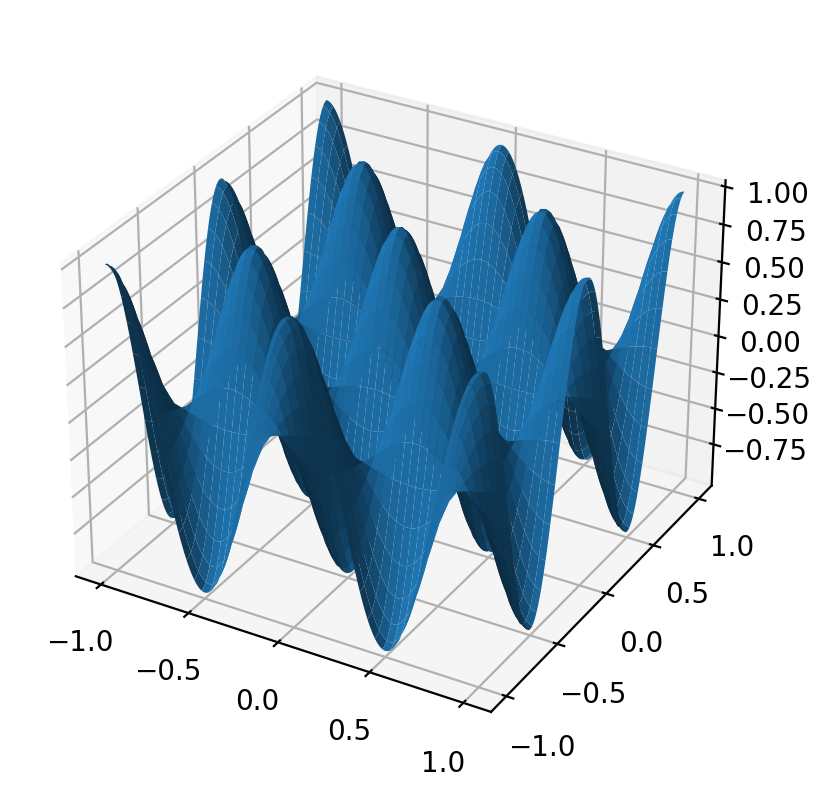

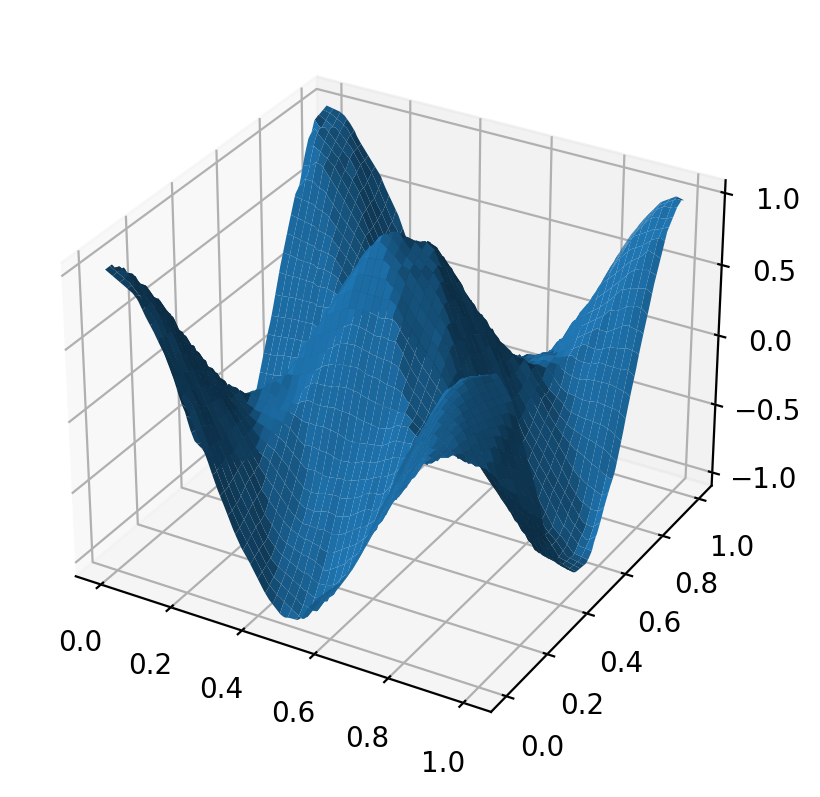

assembling the matrix time taken:  0.002093791961669922
solving Ax = b time taken:  0.007437229156494141


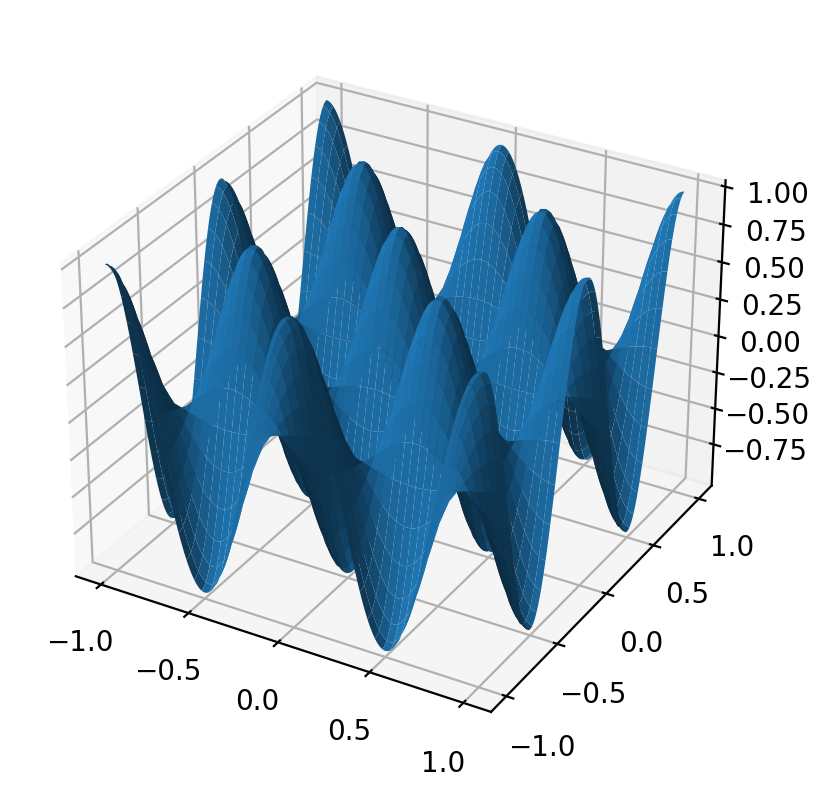

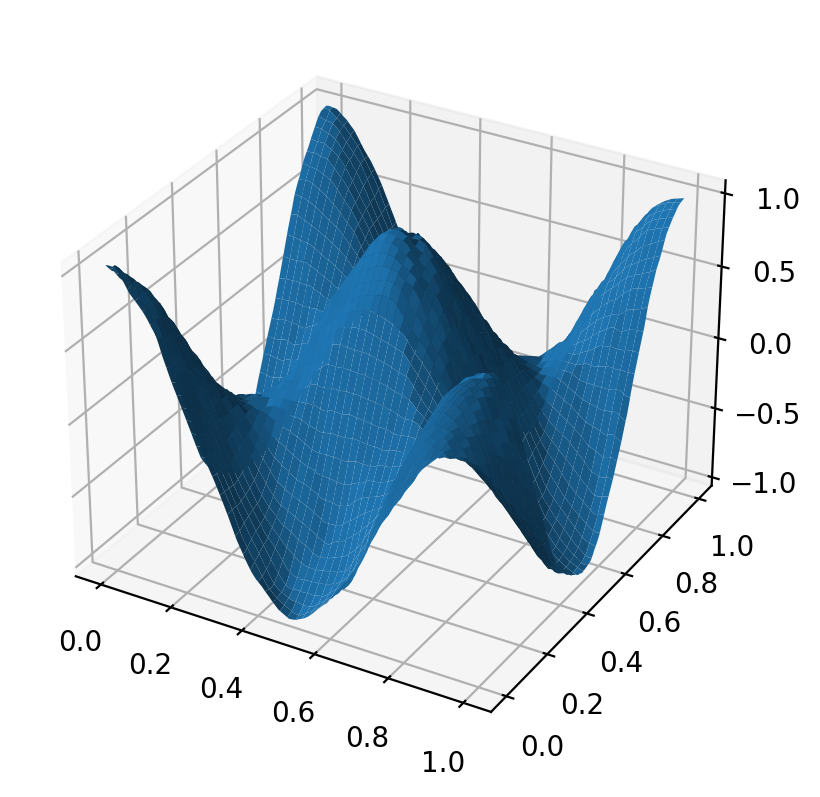

In [6]:
# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    return torch.cos(2 * pi*x[:,0:1]) * torch.cos(2 * pi*x[:,1:2]) 

# integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(50, 3,bl = [-1,-1],ur = [1,1])
integration_weights, integration_points = PiecewiseGQ2D_weights_points(50, 3)
integration_weights = integration_weights.to(device)
integration_points = integration_points.to(device)
neuron_nums = [160]
for neuron_num in neuron_nums: 
    my_model = model(2, neuron_num, 1, k = 1).to(device) 
    my_model = adjust_neuron_position(my_model.cpu(),dims=2,choice=1).to(device) 
    sol = minimize_linear_layer_explicit_assemble(my_model,target,integration_weights,integration_points,solver="direct") 
    my_model.fc2.weight.data[0,:] = sol[:]
    plot_2D(target,[-1,-1],[1,1])
    # plot_2D(my_model,[-1,-1],[1,1])  
    plot_2D(my_model.cpu())  


def target(x):
    return torch.cos(2 * pi*x[:,0:1]) * torch.cos(2 * pi*x[:,1:2]) 

integration_weights, integration_points = PiecewiseGQ2D_weights_points(50, 3,bl = [-1,-1],ur = [1,1])
integration_weights = integration_weights.to(device)
integration_points = integration_points.to(device)
neuron_nums = [640]
for neuron_num in neuron_nums: 
    my_model = model(2, neuron_num, 1, k = 1).to(device) 
    my_model = adjust_neuron_position(my_model.cpu(),dims=2,choice=2).to(device) 
    sol = minimize_linear_layer_explicit_assemble(my_model,target,integration_weights,integration_points,solver="direct") 
    my_model.fc2.weight.data[0,:] = sol[:]
    plot_2D(target,[-1,-1],[1,1])
    # plot_2D(my_model,[-1,-1],[1,1])  
    plot_2D(my_model.cpu())  


In [7]:
def OGAL2FittingReLU2D(my_model,target,N_list,num_epochs,plot_freq, Nx, order, k =1, linear_solver = "direct",Domain = [[0,0],[1,1]]): 
    """ Orthogonal greedy algorithm using 1D ReLU dictionary over [-pi,pi]
    Parameters
    ----------
    my_model: 
        nn model 
    target: 
        target function
    num_epochs: int 
        number of training epochs 
    integration_intervals: int 
        number of subintervals for piecewise numerical quadrature 

    Returns
    -------
    err: tensor 
        rank 1 torch tensor to record the L2 error history  
    model: 
        trained nn model 
    """
    #Todo Done
    gw_expand, integration_points = PiecewiseGQ2D_weights_points(Nx, order,Domain[0],Domain[1])
    gw_expand = gw_expand.to(device)
    integration_points = integration_points.to(device)

    err = torch.zeros(num_epochs+1)
    if my_model == None: 
        func_values = target(integration_points)
        num_neuron = 0

        list_b = []
        list_w = []
    else: 
        func_values = target(integration_points) - my_model(integration_points).detach()
        bias = my_model.fc1.bias.detach().data
        weights = my_model.fc1.weight.detach().data
        num_neuron = int(bias.size(0))

        list_b = list(bias)
        list_w = list(weights)
    
    # initial error Todo Done
    func_values_sqrd = func_values*func_values
    # print(func_values_sqrd.size())
    # print(gw_expand.size()) 
    err[0]= torch.sum(func_values_sqrd*gw_expand)**0.5
    start_time = time.time()
    solver = linear_solver
    relu_dict_parameters = generate_relu_dict2D(N_list).to(device)
    print("using linear solver: ",solver)
    for i in range(num_epochs): 
        print("epoch: ",i+1, end = '\t')
        if num_neuron == 0: 
            func_values = target(integration_points)
        else: 
            func_values = target(integration_points) - my_model(integration_points).detach()

        weight_func_values = func_values*gw_expand  
        basis_values = (F.relu( torch.matmul(integration_points,relu_dict_parameters[:,0:2].T ) - relu_dict_parameters[:,2])**k).T # uses broadcasting

        output = torch.abs(torch.matmul(basis_values,weight_func_values)) # 
        neuron_index = torch.argmax(output.flatten())
        
        # print(neuron_index)
        list_w.append(relu_dict_parameters[neuron_index,0:2]) # 
        list_b.append(-relu_dict_parameters[neuron_index,2])
        num_neuron += 1
        my_model = model(2,num_neuron,1,k).to(device)
        w_tensor = torch.stack(list_w, 0 ) 
        b_tensor = torch.tensor(list_b)
        my_model.fc1.weight.data[:,:] = w_tensor[:,:]
        my_model.fc1.bias.data[:] = b_tensor[:]

        #Todo Done 
#         sol = minimize_linear_layer(my_model,target,solver,Nx,order)
        sol = minimize_linear_layer_explicit_assemble(my_model,target,gw_expand, integration_points, solver)

        my_model.fc2.weight.data[0,:] = sol[:]
        if (i+1)%plot_freq == 0: 
            plot_2D(my_model.cpu())
            my_model = my_model.to(device)

        func_values = target(integration_points) - my_model(integration_points).detach()
        func_values_sqrd = func_values*func_values

        #Todo Done 
        err[i+1]= torch.sum(func_values_sqrd*gw_expand)**0.5
    print("time taken: ",time.time() - start_time)
    return err, my_model


def generate_relu_dict2D(N_list):
    N1 = N_list[0] 
    N2 = N_list[1]
    
    theta = np.linspace(0, 2*pi, N1, endpoint= False).reshape(N1,1)
    W1 = np.cos(theta)
    W2 = np.sin(theta)
    W = np.concatenate((W1,W2),1) # N1 x 2
    b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1)
    
    index1 = np.arange(N1)
    index2 = np.arange(N2)
    ordered_pairs = np.array(np.meshgrid(index1,index2,indexing='ij'))

    ordered_pairs = ordered_pairs.reshape(2,-1).T
    W = W[ordered_pairs[:,0],:]
    b = b[ordered_pairs[:,1],:]
    Wb = np.concatenate((W,b),1) # N1 x 3 
    Wb_tensor = torch.from_numpy(Wb) 
    return Wb_tensor

N_list = [10,20]
Wb = generate_relu_dict2D(N_list).to(device)
print(Wb.shape)


# def generate_relu_dict2D_QMC(s,N0):
#     # add this method to your notes... otherwise you will forget it 
#     # Generate randomized Sobol sequence 
    
# #     Sob = torch.quasirandom.SobolEngine(dimension =2, scramble= True, seed=None) 
# #     samples = Sob.draw(N0).double()

# #     for i in range(s-1):
# #         samples = torch.cat([samples,Sob.draw(N0).double()],0)

#     samples = torch.rand(s*N0,2) 
    
#     T =torch.tensor([[2*pi,0],[0,2.84]])

#     shift = torch.tensor([0,-1.42]) 

#     samples = samples@T + shift 

#     theta = samples[:,0].reshape(s*N0,1)
#     W1 = torch.cos(theta)
#     W2 = torch.sin(theta)
#     W = torch.cat((W1,W2),1) # N1 x 2
#     # b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1) 
#     b = samples[:,1].reshape(s*N0,1)
    
#     Wb = torch.cat((W,b),1) # N1 x 3 

#     return Wb 

def generate_relu_dict2D_QMC_new(s,N0):
    # add this method to your notes... otherwise you will forget it 
    samples = torch.randn(s*N0,3) 
    
    samples = samples/samples.norm(dim=1,keepdim=True)  
    
    Wb = samples 

    return Wb 

def OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =1, linear_solver = "direct",Domain = [[0,0],[1,1]]): 
    """ Orthogonal greedy algorithm using 1D ReLU dictionary over [-pi,pi]
    Parameters
    ----------
    my_model: 
        nn model 
    target: 
        target function
    num_epochs: int 
        number of training epochs 
    integration_intervals: int 
        number of subintervals for piecewise numerical quadrature 

    Returns
    -------
    err: tensor 
        rank 1 torch tensor to record the L2 error history  
    model: 
        trained nn model 
    """
    #Todo Done
    gw_expand, integration_points = PiecewiseGQ2D_weights_points(Nx, order,Domain[0],Domain[1])
    gw_expand = gw_expand.to(device)
    integration_points = integration_points.to(device)

    err = torch.zeros(num_epochs+1)
    if my_model == None: 
        func_values = target(integration_points)
        num_neuron = 0

        list_b = []
        list_w = []
    else: 
        func_values = target(integration_points) - my_model(integration_points).detach()
        bias = my_model.fc1.bias.detach().data
        weights = my_model.fc1.weight.detach().data
        num_neuron = int(bias.size(0))

        list_b = list(bias)
        list_w = list(weights)
    
    # initial error Todo Done
    func_values_sqrd = func_values*func_values
    err[0]= torch.sum(func_values_sqrd*gw_expand)**0.5
    start_time = time.time()
    
    solver = linear_solver
    print("using linear solver: ",solver)
    for i in range(num_epochs): 
        relu_dict_parameters = generate_relu_dict2D_QMC_new(s,N0).to(device) 
        print("epoch: ",i+1, end = '\t')
        if num_neuron == 0: 
            func_values = target(integration_points)
        else: 
            func_values = target(integration_points) - my_model(integration_points).detach()

        weight_func_values = func_values*gw_expand  
        basis_values = (F.relu( torch.matmul(integration_points,relu_dict_parameters[:,0:2].T ) - relu_dict_parameters[:,2])**k).T # uses broadcasting

        output = torch.abs(torch.matmul(basis_values,weight_func_values)) # 
        neuron_index = torch.argmax(output.flatten())
        
        # print(neuron_index)
        list_w.append(relu_dict_parameters[neuron_index,0:2]) # 
        list_b.append(-relu_dict_parameters[neuron_index,2])
        num_neuron += 1
        my_model = model(2,num_neuron,1,k).to(device)
        w_tensor = torch.stack(list_w, 0 ) 
        b_tensor = torch.tensor(list_b)
        my_model.fc1.weight.data[:,:] = w_tensor[:,:]
        my_model.fc1.bias.data[:] = b_tensor[:]

        #Todo 
#         sol = minimize_linear_layer(my_model,target,solver,Nx,order)
        sol = minimize_linear_layer_explicit_assemble(my_model,target,gw_expand, integration_points, solver)

        my_model.fc2.weight.data[0,:] = sol[:]
        if (i+1)%plot_freq == 0: 
            plot_2D(my_model.cpu(),Domain[0],Domain[1])
            my_model = my_model.to(device)

        func_values = target(integration_points) - my_model(integration_points).detach()
        func_values_sqrd = func_values*func_values

        #Todo Done 
        err[i+1]= torch.sum(func_values_sqrd*gw_expand)**0.5
    print("time taken: ",time.time() - start_time)
    return err, my_model


torch.Size([200, 3])


In [8]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {}  \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )


## mesa example, sharp interface test 

using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.00019407272338867188
epoch:  2	assembling the matrix time taken:  0.0002288818359375
solving Ax = b time taken:  0.00012993812561035156
epoch:  3	assembling the matrix time taken:  0.00021600723266601562
solving Ax = b time taken:  0.00012731552124023438
epoch:  4	assembling the matrix time taken:  0.0002219676971435547
solving Ax = b time taken:  0.00012111663818359375
epoch:  5	assembling the matrix time taken:  0.00021409988403320312
solving Ax = b time taken:  0.00012373924255371094
epoch:  6	assembling the matrix time taken:  0.00021457672119140625
solving Ax = b time taken:  0.00012254714965820312
epoch:  7	assembling the matrix time taken:  0.00020933151245117188
solving Ax = b time taken:  0.00012063980102539062
epoch:  8	assembling the matrix time taken:  0.0002224445343017578
solving Ax = b time taken:  0.00012183189392089844
epoch:  9	assembling the 

epoch:  70	assembling the matrix time taken:  0.00029540061950683594
solving Ax = b time taken:  0.0004565715789794922
epoch:  71	assembling the matrix time taken:  0.00025844573974609375
solving Ax = b time taken:  0.0004489421844482422
epoch:  72	assembling the matrix time taken:  0.00023508071899414062
solving Ax = b time taken:  0.00048160552978515625
epoch:  73	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.0004911422729492188
epoch:  74	assembling the matrix time taken:  0.00027942657470703125
solving Ax = b time taken:  0.00047016143798828125
epoch:  75	assembling the matrix time taken:  0.00023603439331054688
solving Ax = b time taken:  0.0005068778991699219
epoch:  76	assembling the matrix time taken:  0.00023317337036132812
solving Ax = b time taken:  0.0005066394805908203
epoch:  77	assembling the matrix time taken:  0.00026679039001464844
solving Ax = b time taken:  0.00048065185546875
epoch:  78	assembling the matrix time taken:  0.

epoch:  146	assembling the matrix time taken:  0.0002923011779785156
solving Ax = b time taken:  0.0012578964233398438
epoch:  147	assembling the matrix time taken:  0.00026535987854003906
solving Ax = b time taken:  0.0013263225555419922
epoch:  148	assembling the matrix time taken:  0.0002665519714355469
solving Ax = b time taken:  0.0013079643249511719
epoch:  149	assembling the matrix time taken:  0.00030803680419921875
solving Ax = b time taken:  0.0012941360473632812
epoch:  150	assembling the matrix time taken:  0.0002894401550292969
solving Ax = b time taken:  0.0013091564178466797
epoch:  151	assembling the matrix time taken:  0.0003058910369873047
solving Ax = b time taken:  0.0012993812561035156
epoch:  152	assembling the matrix time taken:  0.0002713203430175781
solving Ax = b time taken:  0.001310586929321289
epoch:  153	assembling the matrix time taken:  0.0002894401550292969
solving Ax = b time taken:  0.0013289451599121094
epoch:  154	assembling the matrix time taken:  

epoch:  227	assembling the matrix time taken:  0.0003123283386230469
solving Ax = b time taken:  0.001771688461303711
epoch:  228	assembling the matrix time taken:  0.0002856254577636719
solving Ax = b time taken:  0.0018148422241210938
epoch:  229	assembling the matrix time taken:  0.0002903938293457031
solving Ax = b time taken:  0.0018415451049804688
epoch:  230	assembling the matrix time taken:  0.0002803802490234375
solving Ax = b time taken:  0.0018665790557861328
epoch:  231	assembling the matrix time taken:  0.0002853870391845703
solving Ax = b time taken:  0.0018491744995117188
epoch:  232	assembling the matrix time taken:  0.00028514862060546875
solving Ax = b time taken:  0.0018267631530761719
epoch:  233	assembling the matrix time taken:  0.0002739429473876953
solving Ax = b time taken:  0.001888275146484375
epoch:  234	assembling the matrix time taken:  0.0002818107604980469
solving Ax = b time taken:  0.0018792152404785156
epoch:  235	assembling the matrix time taken:  0.

epoch:  300	assembling the matrix time taken:  0.00028896331787109375
solving Ax = b time taken:  0.0027627944946289062
epoch:  301	assembling the matrix time taken:  0.000286102294921875
solving Ax = b time taken:  0.002806425094604492
epoch:  302	assembling the matrix time taken:  0.0002865791320800781
solving Ax = b time taken:  0.0028030872344970703
epoch:  303	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.0028285980224609375
epoch:  304	assembling the matrix time taken:  0.00028634071350097656
solving Ax = b time taken:  0.0027773380279541016
epoch:  305	assembling the matrix time taken:  0.00028634071350097656
solving Ax = b time taken:  0.0028460025787353516
epoch:  306	assembling the matrix time taken:  0.00027632713317871094
solving Ax = b time taken:  0.0028426647186279297
epoch:  307	assembling the matrix time taken:  0.0002627372741699219
solving Ax = b time taken:  0.0028781890869140625
epoch:  308	assembling the matrix time taken:

epoch:  377	assembling the matrix time taken:  0.00027108192443847656
solving Ax = b time taken:  0.0036783218383789062
epoch:  378	assembling the matrix time taken:  0.0002772808074951172
solving Ax = b time taken:  0.003663778305053711
epoch:  379	assembling the matrix time taken:  0.0002601146697998047
solving Ax = b time taken:  0.0036954879760742188
epoch:  380	assembling the matrix time taken:  0.0002846717834472656
solving Ax = b time taken:  0.003645658493041992
epoch:  381	assembling the matrix time taken:  0.0002620220184326172
solving Ax = b time taken:  0.0037140846252441406
epoch:  382	assembling the matrix time taken:  0.0002918243408203125
solving Ax = b time taken:  0.0036673545837402344
epoch:  383	assembling the matrix time taken:  0.0002923011779785156
solving Ax = b time taken:  0.00366973876953125
epoch:  384	assembling the matrix time taken:  0.0002830028533935547
solving Ax = b time taken:  0.0036427974700927734
epoch:  385	assembling the matrix time taken:  0.00

epoch:  447	assembling the matrix time taken:  0.0002899169921875
solving Ax = b time taken:  0.004567623138427734
epoch:  448	assembling the matrix time taken:  0.0002646446228027344
solving Ax = b time taken:  0.004576444625854492
epoch:  449	assembling the matrix time taken:  0.0002620220184326172
solving Ax = b time taken:  0.004827260971069336
epoch:  450	assembling the matrix time taken:  0.0003204345703125
solving Ax = b time taken:  0.004731416702270508
epoch:  451	assembling the matrix time taken:  0.0002872943878173828
solving Ax = b time taken:  0.004797697067260742
epoch:  452	assembling the matrix time taken:  0.00029921531677246094
solving Ax = b time taken:  0.0047473907470703125
epoch:  453	assembling the matrix time taken:  0.00029015541076660156
solving Ax = b time taken:  0.004799604415893555
epoch:  454	assembling the matrix time taken:  0.0002675056457519531
solving Ax = b time taken:  0.004835605621337891
epoch:  455	assembling the matrix time taken:  0.0003049373

epoch:  520	assembling the matrix time taken:  0.00024700164794921875
solving Ax = b time taken:  0.0059392452239990234
epoch:  521	assembling the matrix time taken:  0.0002474784851074219
solving Ax = b time taken:  0.0060465335845947266
epoch:  522	assembling the matrix time taken:  0.0002689361572265625
solving Ax = b time taken:  0.006008148193359375
epoch:  523	assembling the matrix time taken:  0.00024819374084472656
solving Ax = b time taken:  0.006061077117919922
epoch:  524	assembling the matrix time taken:  0.0002655982971191406
solving Ax = b time taken:  0.005993366241455078
epoch:  525	assembling the matrix time taken:  0.0002765655517578125
solving Ax = b time taken:  0.006064653396606445
epoch:  526	assembling the matrix time taken:  0.0002751350402832031
solving Ax = b time taken:  0.00604701042175293
epoch:  527	assembling the matrix time taken:  0.000278472900390625
solving Ax = b time taken:  0.006047725677490234
epoch:  528	assembling the matrix time taken:  0.00028

solving Ax = b time taken:  0.007133007049560547
epoch:  596	assembling the matrix time taken:  0.0002658367156982422
solving Ax = b time taken:  0.00708460807800293
epoch:  597	assembling the matrix time taken:  0.00026488304138183594
solving Ax = b time taken:  0.007149457931518555
epoch:  598	assembling the matrix time taken:  0.00026798248291015625
solving Ax = b time taken:  0.007141590118408203
epoch:  599	assembling the matrix time taken:  0.00025653839111328125
solving Ax = b time taken:  0.007180452346801758
epoch:  600	assembling the matrix time taken:  0.0002703666687011719
solving Ax = b time taken:  0.007099628448486328
epoch:  601	assembling the matrix time taken:  0.00027561187744140625
solving Ax = b time taken:  0.007168292999267578
epoch:  602	assembling the matrix time taken:  0.00025534629821777344
solving Ax = b time taken:  0.00717473030090332
epoch:  603	assembling the matrix time taken:  0.0005729198455810547
solving Ax = b time taken:  0.0068476200103759766
epo

solving Ax = b time taken:  0.008794546127319336
epoch:  666	assembling the matrix time taken:  0.00024390220642089844
solving Ax = b time taken:  0.00875401496887207
epoch:  667	assembling the matrix time taken:  0.00027680397033691406
solving Ax = b time taken:  0.008751869201660156
epoch:  668	assembling the matrix time taken:  0.0002646446228027344
solving Ax = b time taken:  0.00873708724975586
epoch:  669	assembling the matrix time taken:  0.00026679039001464844
solving Ax = b time taken:  0.008847236633300781
epoch:  670	assembling the matrix time taken:  0.00026416778564453125
solving Ax = b time taken:  0.008753776550292969
epoch:  671	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.008765935897827148
epoch:  672	assembling the matrix time taken:  0.0002677440643310547
solving Ax = b time taken:  0.008703231811523438
epoch:  673	assembling the matrix time taken:  0.0002651214599609375
solving Ax = b time taken:  0.008875608444213867
epoch

epoch:  735	assembling the matrix time taken:  0.0002675056457519531
solving Ax = b time taken:  0.00983572006225586
epoch:  736	assembling the matrix time taken:  0.0002460479736328125
solving Ax = b time taken:  0.009844541549682617
epoch:  737	assembling the matrix time taken:  0.0002796649932861328
solving Ax = b time taken:  0.009983301162719727
epoch:  738	assembling the matrix time taken:  0.00024390220642089844
solving Ax = b time taken:  0.010000467300415039
epoch:  739	assembling the matrix time taken:  0.0002713203430175781
solving Ax = b time taken:  0.009981393814086914
epoch:  740	assembling the matrix time taken:  0.0002455711364746094
solving Ax = b time taken:  0.009944915771484375
epoch:  741	assembling the matrix time taken:  0.0002503395080566406
solving Ax = b time taken:  0.010041952133178711
epoch:  742	assembling the matrix time taken:  0.0002448558807373047
solving Ax = b time taken:  0.009983062744140625
epoch:  743	assembling the matrix time taken:  0.0002455

epoch:  809	assembling the matrix time taken:  0.0002713203430175781
solving Ax = b time taken:  0.01157069206237793
epoch:  810	assembling the matrix time taken:  0.0002484321594238281
solving Ax = b time taken:  0.011619806289672852
epoch:  811	assembling the matrix time taken:  0.0002701282501220703
solving Ax = b time taken:  0.0116119384765625
epoch:  812	assembling the matrix time taken:  0.00027179718017578125
solving Ax = b time taken:  0.011543035507202148
epoch:  813	assembling the matrix time taken:  0.00027060508728027344
solving Ax = b time taken:  0.011621236801147461
epoch:  814	assembling the matrix time taken:  0.0002593994140625
solving Ax = b time taken:  0.011638164520263672
epoch:  815	assembling the matrix time taken:  0.00026726722717285156
solving Ax = b time taken:  0.011644840240478516
epoch:  816	assembling the matrix time taken:  0.0002608299255371094
solving Ax = b time taken:  0.011561870574951172
epoch:  817	assembling the matrix time taken:  0.0002784729

epoch:  882	assembling the matrix time taken:  0.0002465248107910156
solving Ax = b time taken:  0.012563228607177734
epoch:  883	assembling the matrix time taken:  0.0002830028533935547
solving Ax = b time taken:  0.012609243392944336
epoch:  884	assembling the matrix time taken:  0.0002791881561279297
solving Ax = b time taken:  0.012520074844360352
epoch:  885	assembling the matrix time taken:  0.0002658367156982422
solving Ax = b time taken:  0.012627363204956055
epoch:  886	assembling the matrix time taken:  0.0002696514129638672
solving Ax = b time taken:  0.012594223022460938
epoch:  887	assembling the matrix time taken:  0.0002465248107910156
solving Ax = b time taken:  0.012653112411499023
epoch:  888	assembling the matrix time taken:  0.0002837181091308594
solving Ax = b time taken:  0.012507200241088867
epoch:  889	assembling the matrix time taken:  0.0002493858337402344
solving Ax = b time taken:  0.012683391571044922
epoch:  890	assembling the matrix time taken:  0.0002648

solving Ax = b time taken:  0.014242887496948242
epoch:  957	assembling the matrix time taken:  0.00027251243591308594
solving Ax = b time taken:  0.014364480972290039
epoch:  958	assembling the matrix time taken:  0.00028228759765625
solving Ax = b time taken:  0.014332294464111328
epoch:  959	assembling the matrix time taken:  0.00025010108947753906
solving Ax = b time taken:  0.014394998550415039
epoch:  960	assembling the matrix time taken:  0.0002789497375488281
solving Ax = b time taken:  0.014255523681640625
epoch:  961	assembling the matrix time taken:  0.0002944469451904297
solving Ax = b time taken:  0.014843940734863281
epoch:  962	assembling the matrix time taken:  0.00025963783264160156
solving Ax = b time taken:  0.014805793762207031
epoch:  963	assembling the matrix time taken:  0.0002510547637939453
solving Ax = b time taken:  0.014854669570922852
epoch:  964	assembling the matrix time taken:  0.0002741813659667969
solving Ax = b time taken:  0.014739274978637695
epoch:

solving Ax = b time taken:  0.017093420028686523
epoch:  1028	assembling the matrix time taken:  0.000270843505859375
solving Ax = b time taken:  0.016660690307617188
epoch:  1029	assembling the matrix time taken:  0.0002551078796386719
solving Ax = b time taken:  0.016839265823364258
epoch:  1030	assembling the matrix time taken:  0.0002522468566894531
solving Ax = b time taken:  0.01679682731628418
epoch:  1031	assembling the matrix time taken:  0.0002703666687011719
solving Ax = b time taken:  0.017166852951049805
epoch:  1032	assembling the matrix time taken:  0.00024890899658203125
solving Ax = b time taken:  0.016724109649658203
epoch:  1033	assembling the matrix time taken:  0.00026917457580566406
solving Ax = b time taken:  0.016839027404785156
epoch:  1034	assembling the matrix time taken:  0.00027298927307128906
solving Ax = b time taken:  0.017207622528076172
epoch:  1035	assembling the matrix time taken:  0.0002777576446533203
solving Ax = b time taken:  0.01723265647888183

solving Ax = b time taken:  0.01844930648803711
epoch:  1098	assembling the matrix time taken:  0.0002486705780029297
solving Ax = b time taken:  0.01844620704650879
epoch:  1099	assembling the matrix time taken:  0.00026917457580566406
solving Ax = b time taken:  0.018492698669433594
epoch:  1100	assembling the matrix time taken:  0.000270843505859375
solving Ax = b time taken:  0.018356800079345703
epoch:  1101	assembling the matrix time taken:  0.00024819374084472656
solving Ax = b time taken:  0.0184786319732666
epoch:  1102	assembling the matrix time taken:  0.0002758502960205078
solving Ax = b time taken:  0.018440723419189453
epoch:  1103	assembling the matrix time taken:  0.0002701282501220703
solving Ax = b time taken:  0.01846623420715332
epoch:  1104	assembling the matrix time taken:  0.00027179718017578125
solving Ax = b time taken:  0.018361568450927734
epoch:  1105	assembling the matrix time taken:  0.0002658367156982422
solving Ax = b time taken:  0.018546104431152344
ep

solving Ax = b time taken:  0.0203704833984375
epoch:  1169	assembling the matrix time taken:  0.0002505779266357422
solving Ax = b time taken:  0.020599365234375
epoch:  1170	assembling the matrix time taken:  0.0002727508544921875
solving Ax = b time taken:  0.02056407928466797
epoch:  1171	assembling the matrix time taken:  0.0002505779266357422
solving Ax = b time taken:  0.020652294158935547
epoch:  1172	assembling the matrix time taken:  0.0002760887145996094
solving Ax = b time taken:  0.02051234245300293
epoch:  1173	assembling the matrix time taken:  0.0002856254577636719
solving Ax = b time taken:  0.02054905891418457
epoch:  1174	assembling the matrix time taken:  0.0002760887145996094
solving Ax = b time taken:  0.02059030532836914
epoch:  1175	assembling the matrix time taken:  0.0002739429473876953
solving Ax = b time taken:  0.02064061164855957
epoch:  1176	assembling the matrix time taken:  0.00025534629821777344
solving Ax = b time taken:  0.020532846450805664
epoch:  

solving Ax = b time taken:  0.021192312240600586
epoch:  1241	assembling the matrix time taken:  0.00028061866760253906
solving Ax = b time taken:  0.02130603790283203
epoch:  1242	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.02127838134765625
epoch:  1243	assembling the matrix time taken:  0.00024628639221191406
solving Ax = b time taken:  0.021329879760742188
epoch:  1244	assembling the matrix time taken:  0.0002601146697998047
solving Ax = b time taken:  0.021256685256958008
epoch:  1245	assembling the matrix time taken:  0.00024962425231933594
solving Ax = b time taken:  0.021365642547607422
epoch:  1246	assembling the matrix time taken:  0.0003027915954589844
solving Ax = b time taken:  0.021236896514892578
epoch:  1247	assembling the matrix time taken:  0.00026988983154296875
solving Ax = b time taken:  0.021323680877685547
epoch:  1248	assembling the matrix time taken:  0.0002701282501220703
solving Ax = b time taken:  0.0212051868438720

epoch:  1313	assembling the matrix time taken:  0.0002677440643310547
solving Ax = b time taken:  0.024155855178833008
epoch:  1314	assembling the matrix time taken:  0.0002472400665283203
solving Ax = b time taken:  0.024156570434570312
epoch:  1315	assembling the matrix time taken:  0.0002465248107910156
solving Ax = b time taken:  0.024166584014892578
epoch:  1316	assembling the matrix time taken:  0.0002765655517578125
solving Ax = b time taken:  0.02400064468383789
epoch:  1317	assembling the matrix time taken:  0.0002701282501220703
solving Ax = b time taken:  0.024147510528564453
epoch:  1318	assembling the matrix time taken:  0.0002474784851074219
solving Ax = b time taken:  0.024173259735107422
epoch:  1319	assembling the matrix time taken:  0.0002703666687011719
solving Ax = b time taken:  0.024156808853149414
epoch:  1320	assembling the matrix time taken:  0.00028014183044433594
solving Ax = b time taken:  0.024031400680541992
epoch:  1321	assembling the matrix time taken:  

epoch:  1385	assembling the matrix time taken:  0.00025081634521484375
solving Ax = b time taken:  0.025571346282958984
epoch:  1386	assembling the matrix time taken:  0.00028014183044433594
solving Ax = b time taken:  0.025550127029418945
epoch:  1387	assembling the matrix time taken:  0.0002741813659667969
solving Ax = b time taken:  0.025584936141967773
epoch:  1388	assembling the matrix time taken:  0.0002713203430175781
solving Ax = b time taken:  0.02547311782836914
epoch:  1389	assembling the matrix time taken:  0.00027108192443847656
solving Ax = b time taken:  0.025571584701538086
epoch:  1390	assembling the matrix time taken:  0.00026988983154296875
solving Ax = b time taken:  0.025577545166015625
epoch:  1391	assembling the matrix time taken:  0.0002713203430175781
solving Ax = b time taken:  0.025614261627197266
epoch:  1392	assembling the matrix time taken:  0.0002791881561279297
solving Ax = b time taken:  0.02542877197265625
epoch:  1393	assembling the matrix time taken:

solving Ax = b time taken:  0.028323650360107422
epoch:  1455	assembling the matrix time taken:  0.0002415180206298828
solving Ax = b time taken:  0.028389692306518555
epoch:  1456	assembling the matrix time taken:  0.000263214111328125
solving Ax = b time taken:  0.028205156326293945
epoch:  1457	assembling the matrix time taken:  0.0002636909484863281
solving Ax = b time taken:  0.028458833694458008
epoch:  1458	assembling the matrix time taken:  0.000274658203125
solving Ax = b time taken:  0.028398752212524414
epoch:  1459	assembling the matrix time taken:  0.0002505779266357422
solving Ax = b time taken:  0.027922630310058594
epoch:  1460	assembling the matrix time taken:  0.00024175643920898438
solving Ax = b time taken:  0.02836894989013672
epoch:  1461	assembling the matrix time taken:  0.0002624988555908203
solving Ax = b time taken:  0.028480052947998047
epoch:  1462	assembling the matrix time taken:  0.00026488304138183594
solving Ax = b time taken:  0.027924060821533203
epo

solving Ax = b time taken:  0.030258655548095703
epoch:  1525	assembling the matrix time taken:  0.00027060508728027344
solving Ax = b time taken:  0.030366182327270508
epoch:  1526	assembling the matrix time taken:  0.00027179718017578125
solving Ax = b time taken:  0.030368566513061523
epoch:  1527	assembling the matrix time taken:  0.0002617835998535156
solving Ax = b time taken:  0.030428171157836914
epoch:  1528	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.03026103973388672
epoch:  1529	assembling the matrix time taken:  0.0002598762512207031
solving Ax = b time taken:  0.03044891357421875
epoch:  1530	assembling the matrix time taken:  0.0002377033233642578
solving Ax = b time taken:  0.03043198585510254
epoch:  1531	assembling the matrix time taken:  0.0002608299255371094
solving Ax = b time taken:  0.030442476272583008
epoch:  1532	assembling the matrix time taken:  0.000274658203125
solving Ax = b time taken:  0.03031182289123535
epoc

solving Ax = b time taken:  0.03146624565124512
epoch:  1595	assembling the matrix time taken:  0.00025391578674316406
solving Ax = b time taken:  0.03153276443481445
epoch:  1596	assembling the matrix time taken:  0.00026154518127441406
solving Ax = b time taken:  0.03133273124694824
epoch:  1597	assembling the matrix time taken:  0.00025153160095214844
solving Ax = b time taken:  0.03164196014404297
epoch:  1598	assembling the matrix time taken:  0.0002536773681640625
solving Ax = b time taken:  0.03150629997253418
epoch:  1599	assembling the matrix time taken:  0.00023221969604492188
solving Ax = b time taken:  0.031583309173583984
epoch:  1600	assembling the matrix time taken:  0.0002491474151611328
solving Ax = b time taken:  0.03133106231689453
epoch:  1601	assembling the matrix time taken:  0.0002684593200683594
solving Ax = b time taken:  0.03287029266357422
epoch:  1602	assembling the matrix time taken:  0.00026535987854003906
solving Ax = b time taken:  0.032872915267944336
e

solving Ax = b time taken:  0.036244869232177734
epoch:  1666	assembling the matrix time taken:  0.0002486705780029297
solving Ax = b time taken:  0.036191463470458984
epoch:  1667	assembling the matrix time taken:  0.00026917457580566406
solving Ax = b time taken:  0.03618621826171875
epoch:  1668	assembling the matrix time taken:  0.00026726722717285156
solving Ax = b time taken:  0.03595709800720215
epoch:  1669	assembling the matrix time taken:  0.0002779960632324219
solving Ax = b time taken:  0.03626894950866699
epoch:  1670	assembling the matrix time taken:  0.00026988983154296875
solving Ax = b time taken:  0.036173105239868164
epoch:  1671	assembling the matrix time taken:  0.0002689361572265625
solving Ax = b time taken:  0.03624415397644043
epoch:  1672	assembling the matrix time taken:  0.0002751350402832031
solving Ax = b time taken:  0.0359952449798584
epoch:  1673	assembling the matrix time taken:  0.00026798248291015625
solving Ax = b time taken:  0.03619527816772461
ep

solving Ax = b time taken:  0.036913156509399414
epoch:  1738	assembling the matrix time taken:  0.0002663135528564453
solving Ax = b time taken:  0.03696322441101074
epoch:  1739	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.036998748779296875
epoch:  1740	assembling the matrix time taken:  0.0002770423889160156
solving Ax = b time taken:  0.03677773475646973
epoch:  1741	assembling the matrix time taken:  0.00027441978454589844
solving Ax = b time taken:  0.03697562217712402
epoch:  1742	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.036932945251464844
epoch:  1743	assembling the matrix time taken:  0.0002624988555908203
solving Ax = b time taken:  0.037023067474365234
epoch:  1744	assembling the matrix time taken:  0.0002803802490234375
solving Ax = b time taken:  0.0367732048034668
epoch:  1745	assembling the matrix time taken:  0.00026345252990722656
solving Ax = b time taken:  0.037090301513671875
e

solving Ax = b time taken:  0.04041600227355957
epoch:  1810	assembling the matrix time taken:  0.0002727508544921875
solving Ax = b time taken:  0.04037785530090332
epoch:  1811	assembling the matrix time taken:  0.00024056434631347656
solving Ax = b time taken:  0.040506839752197266
epoch:  1812	assembling the matrix time taken:  0.0002620220184326172
solving Ax = b time taken:  0.04034709930419922
epoch:  1813	assembling the matrix time taken:  0.00026226043701171875
solving Ax = b time taken:  0.040491580963134766
epoch:  1814	assembling the matrix time taken:  0.0002579689025878906
solving Ax = b time taken:  0.040427207946777344
epoch:  1815	assembling the matrix time taken:  0.0002644062042236328
solving Ax = b time taken:  0.04052305221557617
epoch:  1816	assembling the matrix time taken:  0.00024271011352539062
solving Ax = b time taken:  0.04031538963317871
epoch:  1817	assembling the matrix time taken:  0.0002617835998535156
solving Ax = b time taken:  0.04057717323303223
ep

solving Ax = b time taken:  0.041420936584472656
epoch:  1882	assembling the matrix time taken:  0.0002720355987548828
solving Ax = b time taken:  0.04130744934082031
epoch:  1883	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.041367292404174805
epoch:  1884	assembling the matrix time taken:  0.000263214111328125
solving Ax = b time taken:  0.041211843490600586
epoch:  1885	assembling the matrix time taken:  0.0002770423889160156
solving Ax = b time taken:  0.0414125919342041
epoch:  1886	assembling the matrix time taken:  0.0002624988555908203
solving Ax = b time taken:  0.04134202003479004
epoch:  1887	assembling the matrix time taken:  0.00027251243591308594
solving Ax = b time taken:  0.04254746437072754
epoch:  1888	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.04243874549865723
epoch:  1889	assembling the matrix time taken:  0.0002815723419189453
solving Ax = b time taken:  0.0428011417388916
epoch

solving Ax = b time taken:  0.044695377349853516
epoch:  1951	assembling the matrix time taken:  0.0002543926239013672
solving Ax = b time taken:  0.045922040939331055
epoch:  1952	assembling the matrix time taken:  0.00026106834411621094
solving Ax = b time taken:  0.04572486877441406
epoch:  1953	assembling the matrix time taken:  0.0002624988555908203
solving Ax = b time taken:  0.04609036445617676
epoch:  1954	assembling the matrix time taken:  0.0002574920654296875
solving Ax = b time taken:  0.04603838920593262
epoch:  1955	assembling the matrix time taken:  0.000240325927734375
solving Ax = b time taken:  0.046105384826660156
epoch:  1956	assembling the matrix time taken:  0.00029778480529785156
solving Ax = b time taken:  0.04467487335205078
epoch:  1957	assembling the matrix time taken:  0.0002658367156982422
solving Ax = b time taken:  0.046152591705322266
epoch:  1958	assembling the matrix time taken:  0.0002734661102294922
solving Ax = b time taken:  0.046082496643066406
ep

solving Ax = b time taken:  0.04692578315734863
epoch:  2022	assembling the matrix time taken:  0.00024175643920898438
solving Ax = b time taken:  0.046837806701660156
epoch:  2023	assembling the matrix time taken:  0.0002803802490234375
solving Ax = b time taken:  0.04691433906555176
epoch:  2024	assembling the matrix time taken:  0.0002703666687011719
solving Ax = b time taken:  0.046639204025268555
epoch:  2025	assembling the matrix time taken:  0.00024247169494628906
solving Ax = b time taken:  0.04695701599121094
epoch:  2026	assembling the matrix time taken:  0.0002605915069580078
solving Ax = b time taken:  0.046933889389038086
epoch:  2027	assembling the matrix time taken:  0.0002522468566894531
solving Ax = b time taken:  0.04703879356384277
epoch:  2028	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.04679107666015625
epoch:  2029	assembling the matrix time taken:  0.00029277801513671875
solving Ax = b time taken:  0.046920061111450195
e

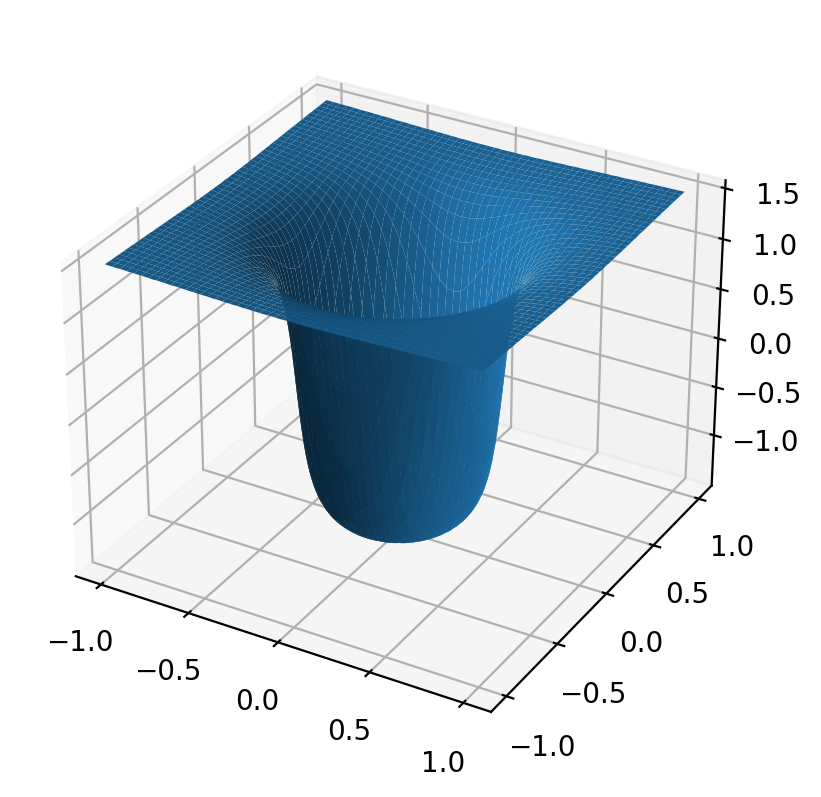

time taken:  89.32505965232849
neuron num 		 error 		 order
4 		 1.608718 		 * 		 

8 		 1.097537 		 0.551641 		 

16 		 0.591061 		 0.892892 		 

32 		 0.353384 		 0.742068 		 

64 		 0.203049 		 0.799408 		 

128 		 0.094906 		 1.097261 		 

256 		 0.037160 		 1.352731 		 

512 		 0.010552 		 1.816309 		 

1024 		 0.002754 		 1.937913 		 

2048 		 0.000730 		 1.915080 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 1.608718 &		 *  \\ \hline  

8 		 &  1.098e+00 &  		 0.55 \\ \hline  

16 		 &  5.911e-01 &  		 0.89 \\ \hline  

32 		 &  3.534e-01 &  		 0.74 \\ \hline  

64 		 &  2.030e-01 &  		 0.80 \\ \hline  

128 		 &  9.491e-02 &  		 1.10 \\ \hline  

256 		 &  3.716e-02 &  		 1.35 \\ \hline  

512 		 &  1.055e-02 &  		 1.82 \\ \hline  

1024 		 &  2.754e-03 &  		 1.94 \\ \hline  

2048 		 &  7.302e-04 &  		 1.92 \\ \hline  



In [27]:

def target(x,alpha = 20):
    r = 0.5 
    y_circle = (x[:,0:1]**2 + x[:,1:2]**2 )**0.5 -r 
    z=  torch.atan(alpha * y_circle) 
    return z 

alpha = 20
function_name = "atan2d-{}".format(alpha) 
filename_write = "data/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n")
f_write.close() 
save = True  
relu_k = 2 

for N0 in [2**12]: 
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 50 
    order = 3 
    exponent = 11  
    num_epochs = 2**exponent
    plot_freq = num_epochs
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k,num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        filename = folder + 'model_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k,num_epochs,s*N0)
        torch.save(my_model.cpu().state_dict(),filename)

    # neuron_nums = [2**j for j in range(2,exponent+1)]
    # err_list = [err_QMC2[i] for i in neuron_nums ]
    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 


In [41]:

for alpha in [20,50,100]:  
    function_name = "atan2d-{}".format(alpha) 
    num_epochs = 2048 
    dict_size = 4096
    relu_k = 1
    exponent = 11 

    folder = 'data_parameter_distribution_compare/'
    filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,dict_size)
    
    err_l2 = torch.load(filename)
    
    show_convergence_order_latex(err_l2,exponent) 
    

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 1.589237 &		 *  \\ \hline  

8 		 &  9.399e-01 &  		 0.76 \\ \hline  

16 		 &  5.875e-01 &  		 0.68 \\ \hline  

32 		 &  3.136e-01 &  		 0.91 \\ \hline  

64 		 &  1.709e-01 &  		 0.88 \\ \hline  

128 		 &  8.356e-02 &  		 1.03 \\ \hline  

256 		 &  3.405e-02 &  		 1.29 \\ \hline  

512 		 &  1.366e-02 &  		 1.32 \\ \hline  

1024 		 &  5.373e-03 &  		 1.35 \\ \hline  

2048 		 &  2.030e-03 &  		 1.40 \\ \hline  

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 1.821037 &		 *  \\ \hline  

8 		 &  1.209e+00 &  		 0.59 \\ \hline  

16 		 &  8.104e-01 &  		 0.58 \\ \hline  

32 		 &  5.199e-01 &  		 0.64 \\ \hline  

64 		 &  3.471e-01 &  		 0.58 \\ \hline  

128 		 &  2.131e-01 &  		 0.70 \\ \hline  

256 		 &  1.021e-01 &  		 1.06 \\ \hline  

512 		 &  4.546e-02 &  		 1.17 \\ \hline  

1024 		 &  1.723e-02 &  		 1.40 \\ \hline  

2048 		 &  6.907e-03 &  		 1.32 \\ \hline  

neuron num  & 	 

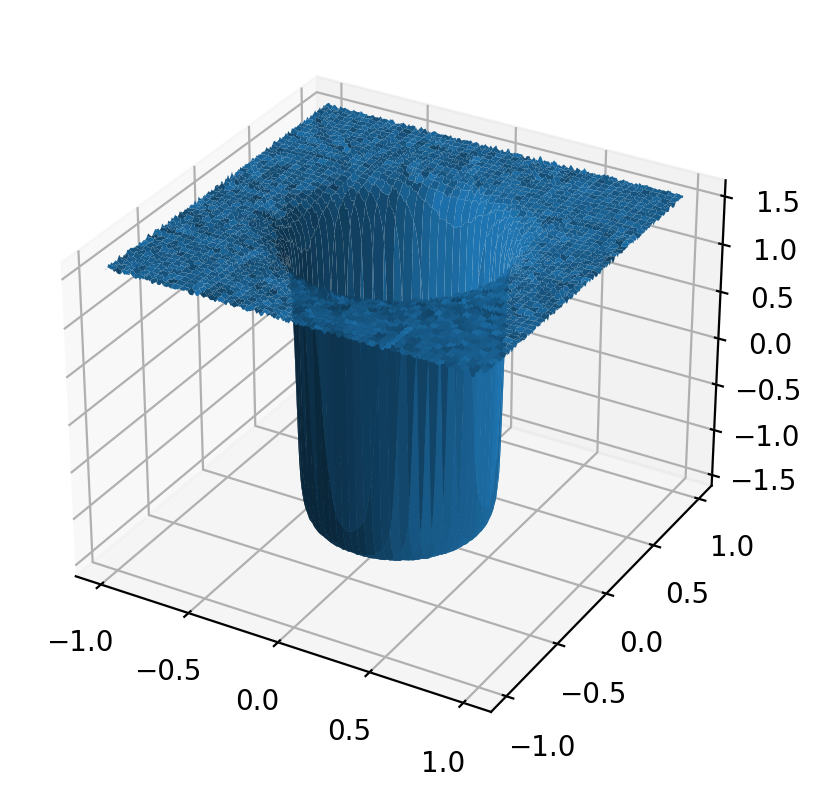

In [35]:
plot_2D(my_model.cpu(),[-1,-1],[1,1])


## Greedy algorithm 

using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.0005822181701660156
solving Ax = b time taken:  0.12961554527282715
epoch:  2	assembling the matrix time taken:  0.0003352165222167969
solving Ax = b time taken:  0.00016927719116210938
epoch:  3	assembling the matrix time taken:  0.00019669532775878906
solving Ax = b time taken:  0.00013136863708496094
epoch:  4	assembling the matrix time taken:  0.00018739700317382812
solving Ax = b time taken:  0.0001266002655029297
epoch:  5	assembling the matrix time taken:  0.00045561790466308594
solving Ax = b time taken:  0.00012373924255371094
epoch:  6	assembling the matrix time taken:  0.00018858909606933594
solving Ax = b time taken:  0.0001220703125
epoch:  7	assembling the matrix time taken:  0.0001842975616455078
solving Ax = b time taken:  0.00012087821960449219
epoch:  8	assembling the matrix time taken:  0.000186920166015625
solving Ax = b time taken:  0.00021219253540039062
epoch:  9	assembling the matrix tim

epoch:  75	assembling the matrix time taken:  0.0002465248107910156
solving Ax = b time taken:  0.0004794597625732422
epoch:  76	assembling the matrix time taken:  0.0002567768096923828
solving Ax = b time taken:  0.00048661231994628906
epoch:  77	assembling the matrix time taken:  0.00022864341735839844
solving Ax = b time taken:  0.000530242919921875
epoch:  78	assembling the matrix time taken:  0.0002446174621582031
solving Ax = b time taken:  0.0005121231079101562
epoch:  79	assembling the matrix time taken:  0.00022411346435546875
solving Ax = b time taken:  0.0005545616149902344
epoch:  80	assembling the matrix time taken:  0.00024366378784179688
solving Ax = b time taken:  0.0005233287811279297
epoch:  81	assembling the matrix time taken:  0.00023865699768066406
solving Ax = b time taken:  0.000553131103515625
epoch:  82	assembling the matrix time taken:  0.0002372264862060547
solving Ax = b time taken:  0.0005588531494140625
epoch:  83	assembling the matrix time taken:  0.00022

epoch:  150	assembling the matrix time taken:  0.0002868175506591797
solving Ax = b time taken:  0.0012907981872558594
epoch:  151	assembling the matrix time taken:  0.00028395652770996094
solving Ax = b time taken:  0.0013320446014404297
epoch:  152	assembling the matrix time taken:  0.0002579689025878906
solving Ax = b time taken:  0.0013206005096435547
epoch:  153	assembling the matrix time taken:  0.00029349327087402344
solving Ax = b time taken:  0.0013315677642822266
epoch:  154	assembling the matrix time taken:  0.00028967857360839844
solving Ax = b time taken:  0.0013263225555419922
epoch:  155	assembling the matrix time taken:  0.00029659271240234375
solving Ax = b time taken:  0.0013370513916015625
epoch:  156	assembling the matrix time taken:  0.0002753734588623047
solving Ax = b time taken:  0.0013408660888671875
epoch:  157	assembling the matrix time taken:  0.0002586841583251953
solving Ax = b time taken:  0.0013871192932128906
epoch:  158	assembling the matrix time taken

epoch:  230	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.001852273941040039
epoch:  231	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.0018854141235351562
epoch:  232	assembling the matrix time taken:  0.00027489662170410156
solving Ax = b time taken:  0.0018455982208251953
epoch:  233	assembling the matrix time taken:  0.0002799034118652344
solving Ax = b time taken:  0.0018858909606933594
epoch:  234	assembling the matrix time taken:  0.00025534629821777344
solving Ax = b time taken:  0.0019054412841796875
epoch:  235	assembling the matrix time taken:  0.0002541542053222656
solving Ax = b time taken:  0.0019152164459228516
epoch:  236	assembling the matrix time taken:  0.0002548694610595703
solving Ax = b time taken:  0.0018944740295410156
epoch:  237	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.0019154548645019531
epoch:  238	assembling the matrix time taken: 

epoch:  303	assembling the matrix time taken:  0.00025653839111328125
solving Ax = b time taken:  0.0028543472290039062
epoch:  304	assembling the matrix time taken:  0.0002865791320800781
solving Ax = b time taken:  0.002789020538330078
epoch:  305	assembling the matrix time taken:  0.0002579689025878906
solving Ax = b time taken:  0.0028831958770751953
epoch:  306	assembling the matrix time taken:  0.0002779960632324219
solving Ax = b time taken:  0.0028531551361083984
epoch:  307	assembling the matrix time taken:  0.00025844573974609375
solving Ax = b time taken:  0.0028994083404541016
epoch:  308	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.002872943878173828
epoch:  309	assembling the matrix time taken:  0.0002582073211669922
solving Ax = b time taken:  0.0029120445251464844
epoch:  310	assembling the matrix time taken:  0.00025725364685058594
solving Ax = b time taken:  0.002903461456298828
epoch:  311	assembling the matrix time taken:  0

epoch:  379	assembling the matrix time taken:  0.0002574920654296875
solving Ax = b time taken:  0.0036916732788085938
epoch:  380	assembling the matrix time taken:  0.00025463104248046875
solving Ax = b time taken:  0.003693819046020508
epoch:  381	assembling the matrix time taken:  0.0002551078796386719
solving Ax = b time taken:  0.0037343502044677734
epoch:  382	assembling the matrix time taken:  0.00026416778564453125
solving Ax = b time taken:  0.0037183761596679688
epoch:  383	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.003707408905029297
epoch:  384	assembling the matrix time taken:  0.0002522468566894531
solving Ax = b time taken:  0.0037076473236083984
epoch:  385	assembling the matrix time taken:  0.00026917457580566406
solving Ax = b time taken:  0.00418853759765625
epoch:  386	assembling the matrix time taken:  0.00026702880859375
solving Ax = b time taken:  0.004193305969238281
epoch:  387	assembling the matrix time taken:  0.000

epoch:  449	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.004822969436645508
epoch:  450	assembling the matrix time taken:  0.0002574920654296875
solving Ax = b time taken:  0.004827260971069336
epoch:  451	assembling the matrix time taken:  0.0002551078796386719
solving Ax = b time taken:  0.004842281341552734
epoch:  452	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.00482487678527832
epoch:  453	assembling the matrix time taken:  0.0002598762512207031
solving Ax = b time taken:  0.0048716068267822266
epoch:  454	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.004868507385253906
epoch:  455	assembling the matrix time taken:  0.0002567768096923828
solving Ax = b time taken:  0.0048449039459228516
epoch:  456	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.004818439483642578
epoch:  457	assembling the matrix time taken:  0.0002

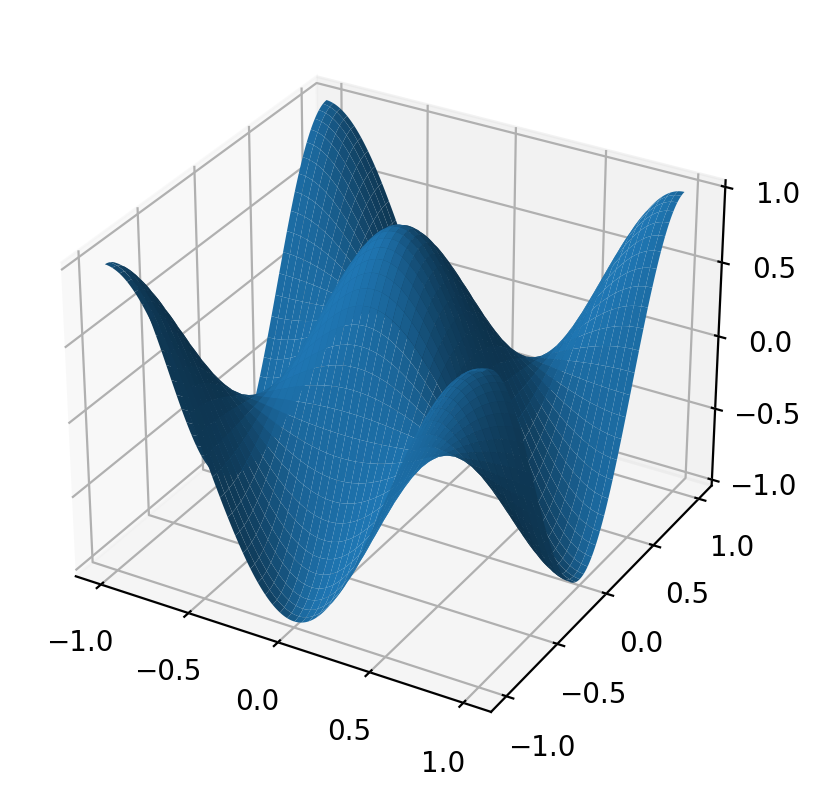

time taken:  9.958250045776367
neuron num 		 error 		 order
4 		 0.935756 		 * 		 

8 		 0.638961 		 0.550404 		 

16 		 0.122628 		 2.381436 		 

32 		 0.045905 		 1.417582 		 

64 		 0.011103 		 2.047676 		 

128 		 0.002647 		 2.068760 		 

256 		 0.000765 		 1.789988 		 

512 		 0.000194 		 1.976432 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.935756 &		 *  \\ \hline  

8 		 &  6.390e-01 &  		 0.55 \\ \hline  

16 		 &  1.226e-01 &  		 2.38 \\ \hline  

32 		 &  4.590e-02 &  		 1.42 \\ \hline  

64 		 &  1.110e-02 &  		 2.05 \\ \hline  

128 		 &  2.647e-03 &  		 2.07 \\ \hline  

256 		 &  7.653e-04 &  		 1.79 \\ \hline  

512 		 &  1.945e-04 &  		 1.98 \\ \hline  



In [7]:
def target(x):
    z=  torch.cos(pi * x[:,0:1]) * torch.cos(pi * x[:,1:2]) 
    return z 

# function_name = "gabor2d" 
function_name = "coscos2d" 
filename_write = "data/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n")
f_write.close() 

for N0 in [2**12]: 
    save = False
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 50 
    order = 3    
    exponent = 9  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data/'
        filename = folder + 'err_OGA_2D_{}_neuron_{}_N_{}_randomized.pt'.format(function_name,num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data/'
        filename = folder + 'model_OGA_2D_{}_neuron_{}_N_{}_randomized.pt'.format(function_name,num_epochs,s*N0)
        torch.save(my_model,filename)

    # neuron_nums = [2**j for j in range(2,exponent+1)]
    # err_list = [err_QMC2[i] for i in neuron_nums ]
    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 
    # f_write.write('dictionary size: {}\n'.format(s*N0))
    # f_write.write("neuron num \t\t error \t\t order\n")
    # print("neuron num \t\t error \t\t order")
    # for i, item in enumerate(err_list):
    #     if i == 0: 
    #         print(neuron_nums[i], end = "\t\t")
    #         print(item, end = "\t\t")
    #         print("*")
    #         f_write.write("{} \t\t {} \t\t * \n".format(neuron_nums[i],item))
    #     else: 
    #         print(neuron_nums[i], end = "\t\t")
    #         print(item, end = "\t\t") 
    #         print(np.log(err_list[i-1]/err_list[i])/np.log(2))
    #         f_write.write("{} \t\t {} \t\t {} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2)))
    # f_write.write("\n")
    # f_write.close()


### non-smooth example 

using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.00023317337036132812
solving Ax = b time taken:  0.00020551681518554688
epoch:  2	assembling the matrix time taken:  0.00020956993103027344
solving Ax = b time taken:  0.00014781951904296875
epoch:  3	assembling the matrix time taken:  0.00019216537475585938
solving Ax = b time taken:  0.00015401840209960938
epoch:  4	assembling the matrix time taken:  0.00022125244140625
solving Ax = b time taken:  0.0002028942108154297
epoch:  5	assembling the matrix time taken:  0.0002257823944091797
solving Ax = b time taken:  0.00014829635620117188
epoch:  6	assembling the matrix time taken:  0.00022220611572265625
solving Ax = b time taken:  0.00014972686767578125
epoch:  7	assembling the matrix time taken:  0.000209808349609375
solving Ax = b time taken:  0.0001556873321533203
epoch:  8	assembling the matrix time taken:  0.0002582073211669922
solving Ax = b time taken:  0.00016355514526367188
epoch:  9	assembling the mat

epoch:  77	assembling the matrix time taken:  0.00025081634521484375
solving Ax = b time taken:  0.0013914108276367188
epoch:  78	assembling the matrix time taken:  0.00030994415283203125
solving Ax = b time taken:  0.0013689994812011719
epoch:  79	assembling the matrix time taken:  0.00024199485778808594
solving Ax = b time taken:  0.0014486312866210938
epoch:  80	assembling the matrix time taken:  0.0002818107604980469
solving Ax = b time taken:  0.0013890266418457031
epoch:  81	assembling the matrix time taken:  0.0002753734588623047
solving Ax = b time taken:  0.0014522075653076172
epoch:  82	assembling the matrix time taken:  0.00031566619873046875
solving Ax = b time taken:  0.0014274120330810547
epoch:  83	assembling the matrix time taken:  0.0002923011779785156
solving Ax = b time taken:  0.0014653205871582031
epoch:  84	assembling the matrix time taken:  0.00032520294189453125
solving Ax = b time taken:  0.001428842544555664
epoch:  85	assembling the matrix time taken:  0.0003

epoch:  151	assembling the matrix time taken:  0.0003724098205566406
solving Ax = b time taken:  0.0029952526092529297
epoch:  152	assembling the matrix time taken:  0.00042128562927246094
solving Ax = b time taken:  0.002943277359008789
epoch:  153	assembling the matrix time taken:  0.00039577484130859375
solving Ax = b time taken:  0.003048419952392578
epoch:  154	assembling the matrix time taken:  0.000385284423828125
solving Ax = b time taken:  0.003047466278076172
epoch:  155	assembling the matrix time taken:  0.0003662109375
solving Ax = b time taken:  0.0031113624572753906
epoch:  156	assembling the matrix time taken:  0.00039124488830566406
solving Ax = b time taken:  0.0030164718627929688
epoch:  157	assembling the matrix time taken:  0.0003886222839355469
solving Ax = b time taken:  0.003114461898803711
epoch:  158	assembling the matrix time taken:  0.00038242340087890625
solving Ax = b time taken:  0.0034132003784179688
epoch:  159	assembling the matrix time taken:  0.000376

epoch:  222	assembling the matrix time taken:  0.0002956390380859375
solving Ax = b time taken:  0.00470423698425293
epoch:  223	assembling the matrix time taken:  0.00029468536376953125
solving Ax = b time taken:  0.004789829254150391
epoch:  224	assembling the matrix time taken:  0.00032258033752441406
solving Ax = b time taken:  0.004666328430175781
epoch:  225	assembling the matrix time taken:  0.00032901763916015625
solving Ax = b time taken:  0.004799365997314453
epoch:  226	assembling the matrix time taken:  0.0003039836883544922
solving Ax = b time taken:  0.0048182010650634766
epoch:  227	assembling the matrix time taken:  0.0003066062927246094
solving Ax = b time taken:  0.004856586456298828
epoch:  228	assembling the matrix time taken:  0.00031113624572753906
solving Ax = b time taken:  0.004776477813720703
epoch:  229	assembling the matrix time taken:  0.00029850006103515625
solving Ax = b time taken:  0.0048847198486328125
epoch:  230	assembling the matrix time taken:  0.0

epoch:  292	assembling the matrix time taken:  0.0003018379211425781
solving Ax = b time taken:  0.0071871280670166016
epoch:  293	assembling the matrix time taken:  0.0003380775451660156
solving Ax = b time taken:  0.007343769073486328
epoch:  294	assembling the matrix time taken:  0.00032591819763183594
solving Ax = b time taken:  0.0073244571685791016
epoch:  295	assembling the matrix time taken:  0.0003063678741455078
solving Ax = b time taken:  0.007403373718261719
epoch:  296	assembling the matrix time taken:  0.0003085136413574219
solving Ax = b time taken:  0.007261037826538086
epoch:  297	assembling the matrix time taken:  0.00033092498779296875
solving Ax = b time taken:  0.007390260696411133
epoch:  298	assembling the matrix time taken:  0.00032210350036621094
solving Ax = b time taken:  0.00731968879699707
epoch:  299	assembling the matrix time taken:  0.0003476142883300781
solving Ax = b time taken:  0.007393836975097656
epoch:  300	assembling the matrix time taken:  0.000

solving Ax = b time taken:  0.009149312973022461
epoch:  362	assembling the matrix time taken:  0.00031065940856933594
solving Ax = b time taken:  0.009085416793823242
epoch:  363	assembling the matrix time taken:  0.000255584716796875
solving Ax = b time taken:  0.009181022644042969
epoch:  364	assembling the matrix time taken:  0.000301361083984375
solving Ax = b time taken:  0.009019613265991211
epoch:  365	assembling the matrix time taken:  0.000274658203125
solving Ax = b time taken:  0.009229183197021484
epoch:  366	assembling the matrix time taken:  0.00028324127197265625
solving Ax = b time taken:  0.009201765060424805
epoch:  367	assembling the matrix time taken:  0.00027942657470703125
solving Ax = b time taken:  0.009192466735839844
epoch:  368	assembling the matrix time taken:  0.00027489662170410156
solving Ax = b time taken:  0.009119749069213867
epoch:  369	assembling the matrix time taken:  0.0002903938293457031
solving Ax = b time taken:  0.009464263916015625
epoch:  3

epoch:  433	assembling the matrix time taken:  0.00035691261291503906
solving Ax = b time taken:  0.01266789436340332
epoch:  434	assembling the matrix time taken:  0.0003762245178222656
solving Ax = b time taken:  0.012627363204956055
epoch:  435	assembling the matrix time taken:  0.000362396240234375
solving Ax = b time taken:  0.012717962265014648
epoch:  436	assembling the matrix time taken:  0.00032782554626464844
solving Ax = b time taken:  0.012556076049804688
epoch:  437	assembling the matrix time taken:  0.0002925395965576172
solving Ax = b time taken:  0.012817621231079102
epoch:  438	assembling the matrix time taken:  0.0002796649932861328
solving Ax = b time taken:  0.01275777816772461
epoch:  439	assembling the matrix time taken:  0.00028514862060546875
solving Ax = b time taken:  0.012835264205932617
epoch:  440	assembling the matrix time taken:  0.00026488304138183594
solving Ax = b time taken:  0.012665033340454102
epoch:  441	assembling the matrix time taken:  0.000277

epoch:  505	assembling the matrix time taken:  0.0003452301025390625
solving Ax = b time taken:  0.013798952102661133
epoch:  506	assembling the matrix time taken:  0.0003662109375
solving Ax = b time taken:  0.013740777969360352
epoch:  507	assembling the matrix time taken:  0.0003528594970703125
solving Ax = b time taken:  0.013820648193359375
epoch:  508	assembling the matrix time taken:  0.0003502368927001953
solving Ax = b time taken:  0.013661384582519531
epoch:  509	assembling the matrix time taken:  0.000324249267578125
solving Ax = b time taken:  0.013935089111328125
epoch:  510	assembling the matrix time taken:  0.00026226043701171875
solving Ax = b time taken:  0.013907909393310547
epoch:  511	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.013952493667602539
epoch:  512	assembling the matrix time taken:  0.00026869773864746094
solving Ax = b time taken:  0.013750791549682617
epoch:  513	assembling the matrix time taken:  0.000262975692

solving Ax = b time taken:  0.01785564422607422
epoch:  576	assembling the matrix time taken:  0.0003361701965332031
solving Ax = b time taken:  0.017600536346435547
epoch:  577	assembling the matrix time taken:  0.0003361701965332031
solving Ax = b time taken:  0.0194246768951416
epoch:  578	assembling the matrix time taken:  0.0003008842468261719
solving Ax = b time taken:  0.019394874572753906
epoch:  579	assembling the matrix time taken:  0.00031447410583496094
solving Ax = b time taken:  0.01945781707763672
epoch:  580	assembling the matrix time taken:  0.0002846717834472656
solving Ax = b time taken:  0.019204139709472656
epoch:  581	assembling the matrix time taken:  0.0003066062927246094
solving Ax = b time taken:  0.019658565521240234
epoch:  582	assembling the matrix time taken:  0.00027108192443847656
solving Ax = b time taken:  0.01953268051147461
epoch:  583	assembling the matrix time taken:  0.00029277801513671875
solving Ax = b time taken:  0.019597291946411133
epoch:  5

solving Ax = b time taken:  0.02368617057800293
epoch:  647	assembling the matrix time taken:  0.0002448558807373047
solving Ax = b time taken:  0.02362823486328125
epoch:  648	assembling the matrix time taken:  0.0002987384796142578
solving Ax = b time taken:  0.023276567459106445
epoch:  649	assembling the matrix time taken:  0.0002810955047607422
solving Ax = b time taken:  0.02357006072998047
epoch:  650	assembling the matrix time taken:  0.0003516674041748047
solving Ax = b time taken:  0.023449420928955078
epoch:  651	assembling the matrix time taken:  0.000438690185546875
solving Ax = b time taken:  0.023517608642578125
epoch:  652	assembling the matrix time taken:  0.0003714561462402344
solving Ax = b time taken:  0.02328801155090332
epoch:  653	assembling the matrix time taken:  0.0004124641418457031
solving Ax = b time taken:  0.023588895797729492
epoch:  654	assembling the matrix time taken:  0.0003802776336669922
solving Ax = b time taken:  0.023562908172607422
epoch:  655	

solving Ax = b time taken:  0.02665114402770996
epoch:  717	assembling the matrix time taken:  0.0003848075866699219
solving Ax = b time taken:  0.02708888053894043
epoch:  718	assembling the matrix time taken:  0.0003821849822998047
solving Ax = b time taken:  0.026987552642822266
epoch:  719	assembling the matrix time taken:  0.00040721893310546875
solving Ax = b time taken:  0.02705979347229004
epoch:  720	assembling the matrix time taken:  0.0003788471221923828
solving Ax = b time taken:  0.026694774627685547
epoch:  721	assembling the matrix time taken:  0.0003418922424316406
solving Ax = b time taken:  0.027068138122558594
epoch:  722	assembling the matrix time taken:  0.0002980232238769531
solving Ax = b time taken:  0.026964902877807617
epoch:  723	assembling the matrix time taken:  0.00030040740966796875
solving Ax = b time taken:  0.027042150497436523
epoch:  724	assembling the matrix time taken:  0.000301361083984375
solving Ax = b time taken:  0.026733875274658203
epoch:  7

epoch:  787	assembling the matrix time taken:  0.0003380775451660156
solving Ax = b time taken:  0.03064250946044922
epoch:  788	assembling the matrix time taken:  0.0003528594970703125
solving Ax = b time taken:  0.03026437759399414
epoch:  789	assembling the matrix time taken:  0.0003209114074707031
solving Ax = b time taken:  0.030774354934692383
epoch:  790	assembling the matrix time taken:  0.0003833770751953125
solving Ax = b time taken:  0.030622005462646484
epoch:  791	assembling the matrix time taken:  0.0003933906555175781
solving Ax = b time taken:  0.03074049949645996
epoch:  792	assembling the matrix time taken:  0.00039124488830566406
solving Ax = b time taken:  0.03031134605407715
epoch:  793	assembling the matrix time taken:  0.0003914833068847656
solving Ax = b time taken:  0.03067493438720703
epoch:  794	assembling the matrix time taken:  0.0003986358642578125
solving Ax = b time taken:  0.030627012252807617
epoch:  795	assembling the matrix time taken:  0.00032687187

epoch:  859	assembling the matrix time taken:  0.00044035911560058594
solving Ax = b time taken:  0.033419132232666016
epoch:  860	assembling the matrix time taken:  0.0003871917724609375
solving Ax = b time taken:  0.03311467170715332
epoch:  861	assembling the matrix time taken:  0.0004038810729980469
solving Ax = b time taken:  0.03357744216918945
epoch:  862	assembling the matrix time taken:  0.0003902912139892578
solving Ax = b time taken:  0.03346967697143555
epoch:  863	assembling the matrix time taken:  0.0003294944763183594
solving Ax = b time taken:  0.033616065979003906
epoch:  864	assembling the matrix time taken:  0.0003063678741455078
solving Ax = b time taken:  0.03320169448852539
epoch:  865	assembling the matrix time taken:  0.000377655029296875
solving Ax = b time taken:  0.033719778060913086
epoch:  866	assembling the matrix time taken:  0.00033974647521972656
solving Ax = b time taken:  0.03373098373413086
epoch:  867	assembling the matrix time taken:  0.00030660629

solving Ax = b time taken:  0.038634538650512695
epoch:  930	assembling the matrix time taken:  0.0003495216369628906
solving Ax = b time taken:  0.03851580619812012
epoch:  931	assembling the matrix time taken:  0.0003724098205566406
solving Ax = b time taken:  0.038620710372924805
epoch:  932	assembling the matrix time taken:  0.00037598609924316406
solving Ax = b time taken:  0.03828549385070801
epoch:  933	assembling the matrix time taken:  0.0003986358642578125
solving Ax = b time taken:  0.03872799873352051
epoch:  934	assembling the matrix time taken:  0.000347137451171875
solving Ax = b time taken:  0.03864789009094238
epoch:  935	assembling the matrix time taken:  0.0003829002380371094
solving Ax = b time taken:  0.03875899314880371
epoch:  936	assembling the matrix time taken:  0.0003898143768310547
solving Ax = b time taken:  0.03830862045288086
epoch:  937	assembling the matrix time taken:  0.00038886070251464844
solving Ax = b time taken:  0.03866767883300781
epoch:  938	a

solving Ax = b time taken:  0.0414280891418457
epoch:  1000	assembling the matrix time taken:  0.00037479400634765625
solving Ax = b time taken:  0.04097914695739746
epoch:  1001	assembling the matrix time taken:  0.00040793418884277344
solving Ax = b time taken:  0.04135251045227051
epoch:  1002	assembling the matrix time taken:  0.00043463706970214844
solving Ax = b time taken:  0.04116988182067871
epoch:  1003	assembling the matrix time taken:  0.00042319297790527344
solving Ax = b time taken:  0.04138493537902832
epoch:  1004	assembling the matrix time taken:  0.00041222572326660156
solving Ax = b time taken:  0.040976524353027344
epoch:  1005	assembling the matrix time taken:  0.0003693103790283203
solving Ax = b time taken:  0.041471242904663086
epoch:  1006	assembling the matrix time taken:  0.0004017353057861328
solving Ax = b time taken:  0.04136967658996582
epoch:  1007	assembling the matrix time taken:  0.0004162788391113281
solving Ax = b time taken:  0.041463375091552734
e

solving Ax = b time taken:  0.049010276794433594
epoch:  1070	assembling the matrix time taken:  0.0004165172576904297
solving Ax = b time taken:  0.04884219169616699
epoch:  1071	assembling the matrix time taken:  0.0003998279571533203
solving Ax = b time taken:  0.0489954948425293
epoch:  1072	assembling the matrix time taken:  0.00042510032653808594
solving Ax = b time taken:  0.04840445518493652
epoch:  1073	assembling the matrix time taken:  0.00040912628173828125
solving Ax = b time taken:  0.04910588264465332
epoch:  1074	assembling the matrix time taken:  0.000396728515625
solving Ax = b time taken:  0.04901576042175293
epoch:  1075	assembling the matrix time taken:  0.0003833770751953125
solving Ax = b time taken:  0.04911613464355469
epoch:  1076	assembling the matrix time taken:  0.00035309791564941406
solving Ax = b time taken:  0.04868960380554199
epoch:  1077	assembling the matrix time taken:  0.0003447532653808594
solving Ax = b time taken:  0.04918551445007324
epoch:  1

epoch:  1140	assembling the matrix time taken:  0.000446319580078125
solving Ax = b time taken:  0.052945613861083984
epoch:  1141	assembling the matrix time taken:  0.00044417381286621094
solving Ax = b time taken:  0.05341148376464844
epoch:  1142	assembling the matrix time taken:  0.0004322528839111328
solving Ax = b time taken:  0.05331110954284668
epoch:  1143	assembling the matrix time taken:  0.0005199909210205078
solving Ax = b time taken:  0.0533604621887207
epoch:  1144	assembling the matrix time taken:  0.00046753883361816406
solving Ax = b time taken:  0.05294919013977051
epoch:  1145	assembling the matrix time taken:  0.0004210472106933594
solving Ax = b time taken:  0.05346989631652832
epoch:  1146	assembling the matrix time taken:  0.00045013427734375
solving Ax = b time taken:  0.05334210395812988
epoch:  1147	assembling the matrix time taken:  0.0004260540008544922
solving Ax = b time taken:  0.05348682403564453
epoch:  1148	assembling the matrix time taken:  0.0004541

solving Ax = b time taken:  0.05869722366333008
epoch:  1210	assembling the matrix time taken:  0.0002856254577636719
solving Ax = b time taken:  0.058353424072265625
epoch:  1211	assembling the matrix time taken:  0.00031638145446777344
solving Ax = b time taken:  0.05850934982299805
epoch:  1212	assembling the matrix time taken:  0.0003848075866699219
solving Ax = b time taken:  0.0581357479095459
epoch:  1213	assembling the matrix time taken:  0.00038909912109375
solving Ax = b time taken:  0.05854058265686035
epoch:  1214	assembling the matrix time taken:  0.0004267692565917969
solving Ax = b time taken:  0.05853581428527832
epoch:  1215	assembling the matrix time taken:  0.0003561973571777344
solving Ax = b time taken:  0.05848574638366699
epoch:  1216	assembling the matrix time taken:  0.0003905296325683594
solving Ax = b time taken:  0.057875871658325195
epoch:  1217	assembling the matrix time taken:  0.0003821849822998047
solving Ax = b time taken:  0.060411691665649414
epoch: 

solving Ax = b time taken:  0.06063055992126465
epoch:  1280	assembling the matrix time taken:  0.00040030479431152344
solving Ax = b time taken:  0.059814453125
epoch:  1281	assembling the matrix time taken:  0.00039386749267578125
solving Ax = b time taken:  0.06646561622619629
epoch:  1282	assembling the matrix time taken:  0.0004038810729980469
solving Ax = b time taken:  0.06637001037597656
epoch:  1283	assembling the matrix time taken:  0.0003414154052734375
solving Ax = b time taken:  0.0666971206665039
epoch:  1284	assembling the matrix time taken:  0.0003409385681152344
solving Ax = b time taken:  0.06632208824157715
epoch:  1285	assembling the matrix time taken:  0.0004260540008544922
solving Ax = b time taken:  0.06689882278442383
epoch:  1286	assembling the matrix time taken:  0.00040411949157714844
solving Ax = b time taken:  0.06679892539978027
epoch:  1287	assembling the matrix time taken:  0.00045013427734375
solving Ax = b time taken:  0.06688499450683594
epoch:  1288	

solving Ax = b time taken:  0.07164621353149414
epoch:  1350	assembling the matrix time taken:  0.0003159046173095703
solving Ax = b time taken:  0.07136321067810059
epoch:  1351	assembling the matrix time taken:  0.00033926963806152344
solving Ax = b time taken:  0.07192659378051758
epoch:  1352	assembling the matrix time taken:  0.0003142356872558594
solving Ax = b time taken:  0.07104778289794922
epoch:  1353	assembling the matrix time taken:  0.00030684471130371094
solving Ax = b time taken:  0.07180094718933105
epoch:  1354	assembling the matrix time taken:  0.0004267692565917969
solving Ax = b time taken:  0.07164740562438965
epoch:  1355	assembling the matrix time taken:  0.0004000663757324219
solving Ax = b time taken:  0.07190179824829102
epoch:  1356	assembling the matrix time taken:  0.0005366802215576172
solving Ax = b time taken:  0.07104778289794922
epoch:  1357	assembling the matrix time taken:  0.0003230571746826172
solving Ax = b time taken:  0.07188296318054199
epoch:

solving Ax = b time taken:  0.07954549789428711
epoch:  1420	assembling the matrix time taken:  0.00040650367736816406
solving Ax = b time taken:  0.07910013198852539
epoch:  1421	assembling the matrix time taken:  0.00035190582275390625
solving Ax = b time taken:  0.07979297637939453
epoch:  1422	assembling the matrix time taken:  0.00031113624572753906
solving Ax = b time taken:  0.07963204383850098
epoch:  1423	assembling the matrix time taken:  0.0003085136413574219
solving Ax = b time taken:  0.07987165451049805
epoch:  1424	assembling the matrix time taken:  0.0004146099090576172
solving Ax = b time taken:  0.07895207405090332
epoch:  1425	assembling the matrix time taken:  0.00039505958557128906
solving Ax = b time taken:  0.07968974113464355
epoch:  1426	assembling the matrix time taken:  0.0004124641418457031
solving Ax = b time taken:  0.07979702949523926
epoch:  1427	assembling the matrix time taken:  0.0003218650817871094
solving Ax = b time taken:  0.08054995536804199
epoc

solving Ax = b time taken:  0.08305621147155762
epoch:  1490	assembling the matrix time taken:  0.0004253387451171875
solving Ax = b time taken:  0.08266425132751465
epoch:  1491	assembling the matrix time taken:  0.00044226646423339844
solving Ax = b time taken:  0.0828402042388916
epoch:  1492	assembling the matrix time taken:  0.00042557716369628906
solving Ax = b time taken:  0.08208513259887695
epoch:  1493	assembling the matrix time taken:  0.00039887428283691406
solving Ax = b time taken:  0.08307719230651855
epoch:  1494	assembling the matrix time taken:  0.00032019615173339844
solving Ax = b time taken:  0.08296632766723633
epoch:  1495	assembling the matrix time taken:  0.0003676414489746094
solving Ax = b time taken:  0.08315205574035645
epoch:  1496	assembling the matrix time taken:  0.0004086494445800781
solving Ax = b time taken:  0.08229589462280273
epoch:  1497	assembling the matrix time taken:  0.0004544258117675781
solving Ax = b time taken:  0.08299374580383301
epoch

epoch:  1560	assembling the matrix time taken:  0.00042247772216796875
solving Ax = b time taken:  0.09284472465515137
epoch:  1561	assembling the matrix time taken:  0.00042057037353515625
solving Ax = b time taken:  0.09338021278381348
epoch:  1562	assembling the matrix time taken:  0.00044846534729003906
solving Ax = b time taken:  0.0923917293548584
epoch:  1563	assembling the matrix time taken:  0.00029730796813964844
solving Ax = b time taken:  0.09157872200012207
epoch:  1564	assembling the matrix time taken:  0.0004074573516845703
solving Ax = b time taken:  0.09063220024108887
epoch:  1565	assembling the matrix time taken:  0.0004470348358154297
solving Ax = b time taken:  0.0914609432220459
epoch:  1566	assembling the matrix time taken:  0.00030803680419921875
solving Ax = b time taken:  0.09116721153259277
epoch:  1567	assembling the matrix time taken:  0.00031065940856933594
solving Ax = b time taken:  0.09168124198913574
epoch:  1568	assembling the matrix time taken:  0.00

solving Ax = b time taken:  0.09620928764343262
epoch:  1631	assembling the matrix time taken:  0.0003330707550048828
solving Ax = b time taken:  0.0969393253326416
epoch:  1632	assembling the matrix time taken:  0.0003509521484375
solving Ax = b time taken:  0.09612488746643066
epoch:  1633	assembling the matrix time taken:  0.0003383159637451172
solving Ax = b time taken:  0.09638357162475586
epoch:  1634	assembling the matrix time taken:  0.0004031658172607422
solving Ax = b time taken:  0.09505414962768555
epoch:  1635	assembling the matrix time taken:  0.00042748451232910156
solving Ax = b time taken:  0.09569954872131348
epoch:  1636	assembling the matrix time taken:  0.0004105567932128906
solving Ax = b time taken:  0.09513163566589355
epoch:  1637	assembling the matrix time taken:  0.0003426074981689453
solving Ax = b time taken:  0.09584426879882812
epoch:  1638	assembling the matrix time taken:  0.00031304359436035156
solving Ax = b time taken:  0.09570145606994629
epoch:  16

epoch:  1701	assembling the matrix time taken:  0.0004258155822753906
solving Ax = b time taken:  0.10508918762207031
epoch:  1702	assembling the matrix time taken:  0.0004742145538330078
solving Ax = b time taken:  0.10476827621459961
epoch:  1703	assembling the matrix time taken:  0.0004420280456542969
solving Ax = b time taken:  0.10518050193786621
epoch:  1704	assembling the matrix time taken:  0.00037217140197753906
solving Ax = b time taken:  0.1044015884399414
epoch:  1705	assembling the matrix time taken:  0.0003879070281982422
solving Ax = b time taken:  0.10455822944641113
epoch:  1706	assembling the matrix time taken:  0.0004246234893798828
solving Ax = b time taken:  0.10496401786804199
epoch:  1707	assembling the matrix time taken:  0.00043082237243652344
solving Ax = b time taken:  0.10500907897949219
epoch:  1708	assembling the matrix time taken:  0.0003032684326171875
solving Ax = b time taken:  0.10401344299316406
epoch:  1709	assembling the matrix time taken:  0.00037

solving Ax = b time taken:  0.11046576499938965
epoch:  1772	assembling the matrix time taken:  0.00043201446533203125
solving Ax = b time taken:  0.10800480842590332
epoch:  1773	assembling the matrix time taken:  0.0003409385681152344
solving Ax = b time taken:  0.10891985893249512
epoch:  1774	assembling the matrix time taken:  0.00045037269592285156
solving Ax = b time taken:  0.10858917236328125
epoch:  1775	assembling the matrix time taken:  0.0004062652587890625
solving Ax = b time taken:  0.10884761810302734
epoch:  1776	assembling the matrix time taken:  0.0003407001495361328
solving Ax = b time taken:  0.109375
epoch:  1777	assembling the matrix time taken:  0.00032448768615722656
solving Ax = b time taken:  0.11025810241699219
epoch:  1778	assembling the matrix time taken:  0.00032806396484375
solving Ax = b time taken:  0.10891866683959961
epoch:  1779	assembling the matrix time taken:  0.00035071372985839844
solving Ax = b time taken:  0.10889601707458496
epoch:  1780	asse

epoch:  1911	assembling the matrix time taken:  0.0004010200500488281
solving Ax = b time taken:  0.12355804443359375
epoch:  1912	assembling the matrix time taken:  0.00043702125549316406
solving Ax = b time taken:  0.12304544448852539
epoch:  1913	assembling the matrix time taken:  0.00041675567626953125
solving Ax = b time taken:  0.12360978126525879
epoch:  1914	assembling the matrix time taken:  0.00036907196044921875
solving Ax = b time taken:  0.12335944175720215
epoch:  1915	assembling the matrix time taken:  0.0003571510314941406
solving Ax = b time taken:  0.1236104965209961
epoch:  1916	assembling the matrix time taken:  0.000385284423828125
solving Ax = b time taken:  0.12270998954772949
epoch:  1917	assembling the matrix time taken:  0.0004172325134277344
solving Ax = b time taken:  0.12352919578552246
epoch:  1918	assembling the matrix time taken:  0.0004303455352783203
solving Ax = b time taken:  0.12352728843688965
epoch:  1919	assembling the matrix time taken:  0.00040

solving Ax = b time taken:  0.13172221183776855
epoch:  1981	assembling the matrix time taken:  0.00045228004455566406
solving Ax = b time taken:  0.1325991153717041
epoch:  1982	assembling the matrix time taken:  0.0004608631134033203
solving Ax = b time taken:  0.13296079635620117
epoch:  1983	assembling the matrix time taken:  0.0005064010620117188
solving Ax = b time taken:  0.1325085163116455
epoch:  1984	assembling the matrix time taken:  0.00046515464782714844
solving Ax = b time taken:  0.13117551803588867
epoch:  1985	assembling the matrix time taken:  0.00044798851013183594
solving Ax = b time taken:  0.13628053665161133
epoch:  1986	assembling the matrix time taken:  0.0004200935363769531
solving Ax = b time taken:  0.13685059547424316
epoch:  1987	assembling the matrix time taken:  0.0004582405090332031
solving Ax = b time taken:  0.1369316577911377
epoch:  1988	assembling the matrix time taken:  0.0004742145538330078
solving Ax = b time taken:  0.1356358528137207
epoch:  1

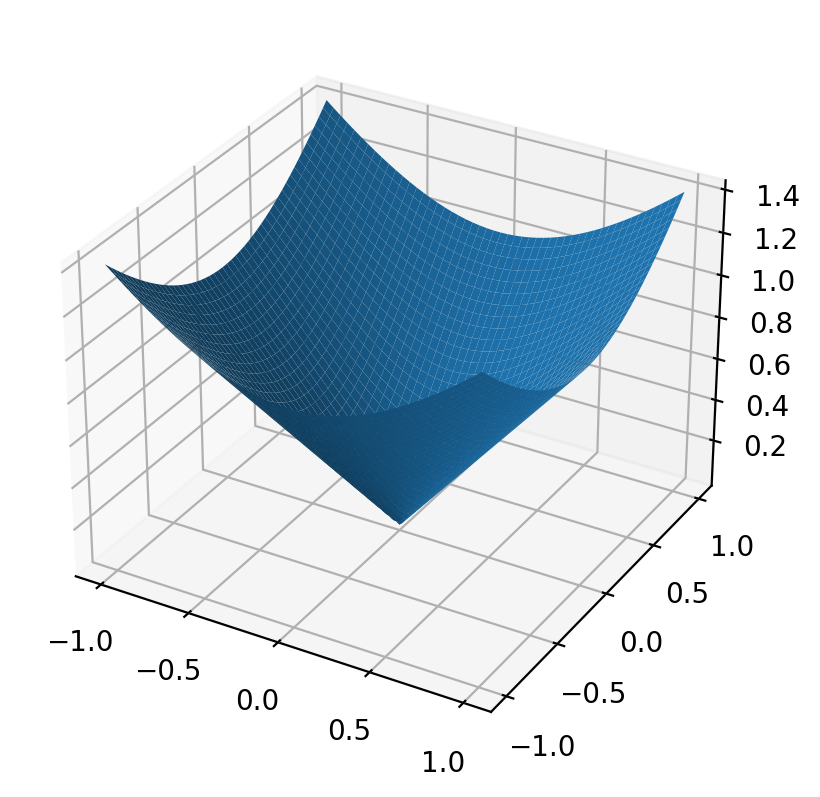

time taken:  205.08457899093628
neuron num 		 error 		 order
4 		 0.345090 		 * 		 

8 		 0.093076 		 1.890497 		 

16 		 0.025720 		 1.855487 		 

32 		 0.008845 		 1.539981 		 

64 		 0.004051 		 1.126468 		 

128 		 0.001348 		 1.587805 		 

256 		 0.000525 		 1.359804 		 

512 		 0.000211 		 1.315348 		 

1024 		 0.000080 		 1.399199 		 

2048 		 0.000030 		 1.393758 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.345090 &		 *  \\ \hline  

8 		 &  9.308e-02 &  		 1.89 \\ \hline  

16 		 &  2.572e-02 &  		 1.86 \\ \hline  

32 		 &  8.845e-03 &  		 1.54 \\ \hline  

64 		 &  4.051e-03 &  		 1.13 \\ \hline  

128 		 &  1.348e-03 &  		 1.59 \\ \hline  

256 		 &  5.251e-04 &  		 1.36 \\ \hline  

512 		 &  2.110e-04 &  		 1.32 \\ \hline  

1024 		 &  8.001e-05 &  		 1.40 \\ \hline  

2048 		 &  3.045e-05 &  		 1.39 \\ \hline  



In [18]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {}  \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )

# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    """ Target function for the Poisson equation
    """
    return (x[:,0:1]**2 + x[:,1:2]**2)**0.5 


# function_name = "gabor2d" 
function_name = "cone2d" 
filename_write = "data_parameter_distribution_compare/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n")
f_write.close() 

for N0 in [2**11]: 
    save = True
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 100 
    order = 3    
    exponent = 11  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'model_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(my_model.state_dict(),filename)

    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 



using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.0002334117889404297
solving Ax = b time taken:  0.0002505779266357422
epoch:  2	assembling the matrix time taken:  0.00026869773864746094
solving Ax = b time taken:  0.00017142295837402344
epoch:  3	assembling the matrix time taken:  0.00026297569274902344
solving Ax = b time taken:  0.00018477439880371094
epoch:  4	assembling the matrix time taken:  0.00030231475830078125
solving Ax = b time taken:  0.00018477439880371094
epoch:  5	assembling the matrix time taken:  0.0003199577331542969
solving Ax = b time taken:  0.00019025802612304688
epoch:  6	assembling the matrix time taken:  0.0002841949462890625
solving Ax = b time taken:  0.00019478797912597656
epoch:  7	assembling the matrix time taken:  0.00031828880310058594
solving Ax = b time taken:  0.0001862049102783203
epoch:  8	assembling the matrix time taken:  0.0002601146697998047
solving Ax = b time taken:  0.00017404556274414062
epoch:  9	assembling the 

epoch:  75	assembling the matrix time taken:  0.0003254413604736328
solving Ax = b time taken:  0.0013041496276855469
epoch:  76	assembling the matrix time taken:  0.0002949237823486328
solving Ax = b time taken:  0.001318216323852539
epoch:  77	assembling the matrix time taken:  0.00037026405334472656
solving Ax = b time taken:  0.0013353824615478516
epoch:  78	assembling the matrix time taken:  0.00040078163146972656
solving Ax = b time taken:  0.001291513442993164
epoch:  79	assembling the matrix time taken:  0.00031280517578125
solving Ax = b time taken:  0.0013988018035888672
epoch:  80	assembling the matrix time taken:  0.00038504600524902344
solving Ax = b time taken:  0.0013120174407958984
epoch:  81	assembling the matrix time taken:  0.0003020763397216797
solving Ax = b time taken:  0.0014531612396240234
epoch:  82	assembling the matrix time taken:  0.00033164024353027344
solving Ax = b time taken:  0.0014269351959228516
epoch:  83	assembling the matrix time taken:  0.00032281

epoch:  150	assembling the matrix time taken:  0.0003676414489746094
solving Ax = b time taken:  0.0029916763305664062
epoch:  151	assembling the matrix time taken:  0.0003845691680908203
solving Ax = b time taken:  0.00301361083984375
epoch:  152	assembling the matrix time taken:  0.00037384033203125
solving Ax = b time taken:  0.0029799938201904297
epoch:  153	assembling the matrix time taken:  0.0003826618194580078
solving Ax = b time taken:  0.003045797348022461
epoch:  154	assembling the matrix time taken:  0.00028228759765625
solving Ax = b time taken:  0.0031251907348632812
epoch:  155	assembling the matrix time taken:  0.0002665519714355469
solving Ax = b time taken:  0.003188610076904297
epoch:  156	assembling the matrix time taken:  0.0002791881561279297
solving Ax = b time taken:  0.0030965805053710938
epoch:  157	assembling the matrix time taken:  0.00034308433532714844
solving Ax = b time taken:  0.0031456947326660156
epoch:  158	assembling the matrix time taken:  0.000275

epoch:  221	assembling the matrix time taken:  0.00037169456481933594
solving Ax = b time taken:  0.004649639129638672
epoch:  222	assembling the matrix time taken:  0.00036215782165527344
solving Ax = b time taken:  0.004682302474975586
epoch:  223	assembling the matrix time taken:  0.00039124488830566406
solving Ax = b time taken:  0.00472259521484375
epoch:  224	assembling the matrix time taken:  0.0003542900085449219
solving Ax = b time taken:  0.004633426666259766
epoch:  225	assembling the matrix time taken:  0.0003495216369628906
solving Ax = b time taken:  0.004769563674926758
epoch:  226	assembling the matrix time taken:  0.00035834312438964844
solving Ax = b time taken:  0.004759550094604492
epoch:  227	assembling the matrix time taken:  0.000370025634765625
solving Ax = b time taken:  0.00481414794921875
epoch:  228	assembling the matrix time taken:  0.0003955364227294922
solving Ax = b time taken:  0.0046765804290771484
epoch:  229	assembling the matrix time taken:  0.00035

epoch:  291	assembling the matrix time taken:  0.00028133392333984375
solving Ax = b time taken:  0.007313966751098633
epoch:  292	assembling the matrix time taken:  0.0003459453582763672
solving Ax = b time taken:  0.007147550582885742
epoch:  293	assembling the matrix time taken:  0.0002923011779785156
solving Ax = b time taken:  0.007383108139038086
epoch:  294	assembling the matrix time taken:  0.00029850006103515625
solving Ax = b time taken:  0.007345676422119141
epoch:  295	assembling the matrix time taken:  0.00028133392333984375
solving Ax = b time taken:  0.007406473159790039
epoch:  296	assembling the matrix time taken:  0.0004286766052246094
solving Ax = b time taken:  0.007130622863769531
epoch:  297	assembling the matrix time taken:  0.0003142356872558594
solving Ax = b time taken:  0.007340669631958008
epoch:  298	assembling the matrix time taken:  0.0002734661102294922
solving Ax = b time taken:  0.007384538650512695
epoch:  299	assembling the matrix time taken:  0.0002

epoch:  361	assembling the matrix time taken:  0.0003275871276855469
solving Ax = b time taken:  0.009062051773071289
epoch:  362	assembling the matrix time taken:  0.0003693103790283203
solving Ax = b time taken:  0.009018421173095703
epoch:  363	assembling the matrix time taken:  0.00033473968505859375
solving Ax = b time taken:  0.009095907211303711
epoch:  364	assembling the matrix time taken:  0.00034117698669433594
solving Ax = b time taken:  0.008985042572021484
epoch:  365	assembling the matrix time taken:  0.0003447532653808594
solving Ax = b time taken:  0.009143590927124023
epoch:  366	assembling the matrix time taken:  0.0003254413604736328
solving Ax = b time taken:  0.009158134460449219
epoch:  367	assembling the matrix time taken:  0.00035262107849121094
solving Ax = b time taken:  0.009162425994873047
epoch:  368	assembling the matrix time taken:  0.0003445148468017578
solving Ax = b time taken:  0.009054899215698242
epoch:  369	assembling the matrix time taken:  0.0003

epoch:  433	assembling the matrix time taken:  0.0003612041473388672
solving Ax = b time taken:  0.012654781341552734
epoch:  434	assembling the matrix time taken:  0.00041294097900390625
solving Ax = b time taken:  0.012575626373291016
epoch:  435	assembling the matrix time taken:  0.00035953521728515625
solving Ax = b time taken:  0.012668848037719727
epoch:  436	assembling the matrix time taken:  0.00028634071350097656
solving Ax = b time taken:  0.01255941390991211
epoch:  437	assembling the matrix time taken:  0.0003104209899902344
solving Ax = b time taken:  0.012765169143676758
epoch:  438	assembling the matrix time taken:  0.0002818107604980469
solving Ax = b time taken:  0.012731790542602539
epoch:  439	assembling the matrix time taken:  0.00030541419982910156
solving Ax = b time taken:  0.012796401977539062
epoch:  440	assembling the matrix time taken:  0.0002865791320800781
solving Ax = b time taken:  0.01262044906616211
epoch:  441	assembling the matrix time taken:  0.00031

epoch:  505	assembling the matrix time taken:  0.00033473968505859375
solving Ax = b time taken:  0.013762950897216797
epoch:  506	assembling the matrix time taken:  0.00031638145446777344
solving Ax = b time taken:  0.013773441314697266
epoch:  507	assembling the matrix time taken:  0.00031876564025878906
solving Ax = b time taken:  0.013811826705932617
epoch:  508	assembling the matrix time taken:  0.00027441978454589844
solving Ax = b time taken:  0.013692378997802734
epoch:  509	assembling the matrix time taken:  0.0002541542053222656
solving Ax = b time taken:  0.014162063598632812
epoch:  510	assembling the matrix time taken:  0.0002906322479248047
solving Ax = b time taken:  0.013865947723388672
epoch:  511	assembling the matrix time taken:  0.0002620220184326172
solving Ax = b time taken:  0.013919353485107422
epoch:  512	assembling the matrix time taken:  0.0003085136413574219
solving Ax = b time taken:  0.013703346252441406
epoch:  513	assembling the matrix time taken:  0.000

solving Ax = b time taken:  0.01783609390258789
epoch:  576	assembling the matrix time taken:  0.00024771690368652344
solving Ax = b time taken:  0.01760721206665039
epoch:  577	assembling the matrix time taken:  0.0003151893615722656
solving Ax = b time taken:  0.019341468811035156
epoch:  578	assembling the matrix time taken:  0.00037980079650878906
solving Ax = b time taken:  0.019246578216552734
epoch:  579	assembling the matrix time taken:  0.0003368854522705078
solving Ax = b time taken:  0.019353866577148438
epoch:  580	assembling the matrix time taken:  0.0003437995910644531
solving Ax = b time taken:  0.01909923553466797
epoch:  581	assembling the matrix time taken:  0.0003654956817626953
solving Ax = b time taken:  0.01943659782409668
epoch:  582	assembling the matrix time taken:  0.0003821849822998047
solving Ax = b time taken:  0.019406795501708984
epoch:  583	assembling the matrix time taken:  0.0003876686096191406
solving Ax = b time taken:  0.019440650939941406
epoch:  5

epoch:  646	assembling the matrix time taken:  0.0002803802490234375
solving Ax = b time taken:  0.023386240005493164
epoch:  647	assembling the matrix time taken:  0.0002562999725341797
solving Ax = b time taken:  0.023527860641479492
epoch:  648	assembling the matrix time taken:  0.0002758502960205078
solving Ax = b time taken:  0.023189067840576172
epoch:  649	assembling the matrix time taken:  0.00027680397033691406
solving Ax = b time taken:  0.02350163459777832
epoch:  650	assembling the matrix time taken:  0.0002675056457519531
solving Ax = b time taken:  0.023427724838256836
epoch:  651	assembling the matrix time taken:  0.0002684593200683594
solving Ax = b time taken:  0.023528575897216797
epoch:  652	assembling the matrix time taken:  0.00029850006103515625
solving Ax = b time taken:  0.023229598999023438
epoch:  653	assembling the matrix time taken:  0.00027251243591308594
solving Ax = b time taken:  0.023584365844726562
epoch:  654	assembling the matrix time taken:  0.00026

epoch:  716	assembling the matrix time taken:  0.00030922889709472656
solving Ax = b time taken:  0.02658534049987793
epoch:  717	assembling the matrix time taken:  0.0002961158752441406
solving Ax = b time taken:  0.027033567428588867
epoch:  718	assembling the matrix time taken:  0.00034928321838378906
solving Ax = b time taken:  0.026905536651611328
epoch:  719	assembling the matrix time taken:  0.00040602684020996094
solving Ax = b time taken:  0.026963233947753906
epoch:  720	assembling the matrix time taken:  0.0003514289855957031
solving Ax = b time taken:  0.026597261428833008
epoch:  721	assembling the matrix time taken:  0.00033092498779296875
solving Ax = b time taken:  0.02698540687561035
epoch:  722	assembling the matrix time taken:  0.0003273487091064453
solving Ax = b time taken:  0.02688455581665039
epoch:  723	assembling the matrix time taken:  0.00030541419982910156
solving Ax = b time taken:  0.026962995529174805
epoch:  724	assembling the matrix time taken:  0.00027

solving Ax = b time taken:  0.030588865280151367
epoch:  788	assembling the matrix time taken:  0.00044846534729003906
solving Ax = b time taken:  0.03011918067932129
epoch:  789	assembling the matrix time taken:  0.00036454200744628906
solving Ax = b time taken:  0.03068065643310547
epoch:  790	assembling the matrix time taken:  0.0003590583801269531
solving Ax = b time taken:  0.030573129653930664
epoch:  791	assembling the matrix time taken:  0.00036454200744628906
solving Ax = b time taken:  0.030658245086669922
epoch:  792	assembling the matrix time taken:  0.00035643577575683594
solving Ax = b time taken:  0.030266761779785156
epoch:  793	assembling the matrix time taken:  0.00036263465881347656
solving Ax = b time taken:  0.030646562576293945
epoch:  794	assembling the matrix time taken:  0.0003533363342285156
solving Ax = b time taken:  0.030573368072509766
epoch:  795	assembling the matrix time taken:  0.0003695487976074219
solving Ax = b time taken:  0.03067183494567871
epoch

solving Ax = b time taken:  0.03342890739440918
epoch:  860	assembling the matrix time taken:  0.000377655029296875
solving Ax = b time taken:  0.03302574157714844
epoch:  861	assembling the matrix time taken:  0.0003521442413330078
solving Ax = b time taken:  0.03353452682495117
epoch:  862	assembling the matrix time taken:  0.00037550926208496094
solving Ax = b time taken:  0.033452510833740234
epoch:  863	assembling the matrix time taken:  0.0003883838653564453
solving Ax = b time taken:  0.03351712226867676
epoch:  864	assembling the matrix time taken:  0.00035071372985839844
solving Ax = b time taken:  0.03304314613342285
epoch:  865	assembling the matrix time taken:  0.00029730796813964844
solving Ax = b time taken:  0.03375506401062012
epoch:  866	assembling the matrix time taken:  0.0003085136413574219
solving Ax = b time taken:  0.033635616302490234
epoch:  867	assembling the matrix time taken:  0.0004379749298095703
solving Ax = b time taken:  0.0337221622467041
epoch:  868	a

solving Ax = b time taken:  0.03857111930847168
epoch:  930	assembling the matrix time taken:  0.000293731689453125
solving Ax = b time taken:  0.03842043876647949
epoch:  931	assembling the matrix time taken:  0.0002875328063964844
solving Ax = b time taken:  0.03852391242980957
epoch:  932	assembling the matrix time taken:  0.0002770423889160156
solving Ax = b time taken:  0.03820943832397461
epoch:  933	assembling the matrix time taken:  0.0002727508544921875
solving Ax = b time taken:  0.03867149353027344
epoch:  934	assembling the matrix time taken:  0.0002841949462890625
solving Ax = b time taken:  0.038787126541137695
epoch:  935	assembling the matrix time taken:  0.0002799034118652344
solving Ax = b time taken:  0.03867626190185547
epoch:  936	assembling the matrix time taken:  0.0002789497375488281
solving Ax = b time taken:  0.038244009017944336
epoch:  937	assembling the matrix time taken:  0.00028133392333984375
solving Ax = b time taken:  0.03863048553466797
epoch:  938	as

solving Ax = b time taken:  0.041301727294921875
epoch:  1000	assembling the matrix time taken:  0.00039315223693847656
solving Ax = b time taken:  0.040871381759643555
epoch:  1001	assembling the matrix time taken:  0.00039315223693847656
solving Ax = b time taken:  0.04124855995178223
epoch:  1002	assembling the matrix time taken:  0.0003464221954345703
solving Ax = b time taken:  0.04113936424255371
epoch:  1003	assembling the matrix time taken:  0.00034809112548828125
solving Ax = b time taken:  0.041287899017333984
epoch:  1004	assembling the matrix time taken:  0.00033211708068847656
solving Ax = b time taken:  0.04090762138366699
epoch:  1005	assembling the matrix time taken:  0.0003249645233154297
solving Ax = b time taken:  0.0413966178894043
epoch:  1006	assembling the matrix time taken:  0.00030517578125
solving Ax = b time taken:  0.04134035110473633
epoch:  1007	assembling the matrix time taken:  0.00031065940856933594
solving Ax = b time taken:  0.04138970375061035
epoch:

solving Ax = b time taken:  0.04882073402404785
epoch:  1070	assembling the matrix time taken:  0.00033283233642578125
solving Ax = b time taken:  0.04868340492248535
epoch:  1071	assembling the matrix time taken:  0.00038361549377441406
solving Ax = b time taken:  0.04878950119018555
epoch:  1072	assembling the matrix time taken:  0.0004754066467285156
solving Ax = b time taken:  0.04820084571838379
epoch:  1073	assembling the matrix time taken:  0.0003895759582519531
solving Ax = b time taken:  0.048929691314697266
epoch:  1074	assembling the matrix time taken:  0.00045013427734375
solving Ax = b time taken:  0.04873347282409668
epoch:  1075	assembling the matrix time taken:  0.0003452301025390625
solving Ax = b time taken:  0.048970699310302734
epoch:  1076	assembling the matrix time taken:  0.0003542900085449219
solving Ax = b time taken:  0.04849386215209961
epoch:  1077	assembling the matrix time taken:  0.00037860870361328125
solving Ax = b time taken:  0.04892754554748535
epoch

epoch:  1140	assembling the matrix time taken:  0.0004184246063232422
solving Ax = b time taken:  0.052866220474243164
epoch:  1141	assembling the matrix time taken:  0.00045871734619140625
solving Ax = b time taken:  0.053336381912231445
epoch:  1142	assembling the matrix time taken:  0.0004773139953613281
solving Ax = b time taken:  0.05309414863586426
epoch:  1143	assembling the matrix time taken:  0.00035858154296875
solving Ax = b time taken:  0.05338597297668457
epoch:  1144	assembling the matrix time taken:  0.0003867149353027344
solving Ax = b time taken:  0.05292057991027832
epoch:  1145	assembling the matrix time taken:  0.0003669261932373047
solving Ax = b time taken:  0.053482770919799805
epoch:  1146	assembling the matrix time taken:  0.0003819465637207031
solving Ax = b time taken:  0.053281545639038086
epoch:  1147	assembling the matrix time taken:  0.0003094673156738281
solving Ax = b time taken:  0.05351877212524414
epoch:  1148	assembling the matrix time taken:  0.000

epoch:  1210	assembling the matrix time taken:  0.0003142356872558594
solving Ax = b time taken:  0.05800342559814453
epoch:  1211	assembling the matrix time taken:  0.0003211498260498047
solving Ax = b time taken:  0.05819559097290039
epoch:  1212	assembling the matrix time taken:  0.0003459453582763672
solving Ax = b time taken:  0.05763697624206543
epoch:  1213	assembling the matrix time taken:  0.0003104209899902344
solving Ax = b time taken:  0.05824708938598633
epoch:  1214	assembling the matrix time taken:  0.0003063678741455078
solving Ax = b time taken:  0.058092355728149414
epoch:  1215	assembling the matrix time taken:  0.0003142356872558594
solving Ax = b time taken:  0.05826425552368164
epoch:  1216	assembling the matrix time taken:  0.0003235340118408203
solving Ax = b time taken:  0.05762648582458496
epoch:  1217	assembling the matrix time taken:  0.0003447532653808594
solving Ax = b time taken:  0.06016874313354492
epoch:  1218	assembling the matrix time taken:  0.00041

epoch:  1280	assembling the matrix time taken:  0.00039887428283691406
solving Ax = b time taken:  0.059645891189575195
epoch:  1281	assembling the matrix time taken:  0.0004553794860839844
solving Ax = b time taken:  0.06623554229736328
epoch:  1282	assembling the matrix time taken:  0.0004227161407470703
solving Ax = b time taken:  0.06609272956848145
epoch:  1283	assembling the matrix time taken:  0.00031828880310058594
solving Ax = b time taken:  0.06638193130493164
epoch:  1284	assembling the matrix time taken:  0.0002810955047607422
solving Ax = b time taken:  0.0658419132232666
epoch:  1285	assembling the matrix time taken:  0.0003552436828613281
solving Ax = b time taken:  0.0664374828338623
epoch:  1286	assembling the matrix time taken:  0.00040268898010253906
solving Ax = b time taken:  0.06618046760559082
epoch:  1287	assembling the matrix time taken:  0.0003185272216796875
solving Ax = b time taken:  0.06642389297485352
epoch:  1288	assembling the matrix time taken:  0.0002

solving Ax = b time taken:  0.07134294509887695
epoch:  1350	assembling the matrix time taken:  0.0005161762237548828
solving Ax = b time taken:  0.07108759880065918
epoch:  1351	assembling the matrix time taken:  0.0005064010620117188
solving Ax = b time taken:  0.07117581367492676
epoch:  1352	assembling the matrix time taken:  0.0005247592926025391
solving Ax = b time taken:  0.07039213180541992
epoch:  1353	assembling the matrix time taken:  0.00040721893310546875
solving Ax = b time taken:  0.07134699821472168
epoch:  1354	assembling the matrix time taken:  0.00040459632873535156
solving Ax = b time taken:  0.07116389274597168
epoch:  1355	assembling the matrix time taken:  0.00036787986755371094
solving Ax = b time taken:  0.07139945030212402
epoch:  1356	assembling the matrix time taken:  0.0003910064697265625
solving Ax = b time taken:  0.07062458992004395
epoch:  1357	assembling the matrix time taken:  0.0003960132598876953
solving Ax = b time taken:  0.07141780853271484
epoch

solving Ax = b time taken:  0.07915949821472168
epoch:  1420	assembling the matrix time taken:  0.00040221214294433594
solving Ax = b time taken:  0.07852697372436523
epoch:  1421	assembling the matrix time taken:  0.00038313865661621094
solving Ax = b time taken:  0.07918381690979004
epoch:  1422	assembling the matrix time taken:  0.0003674030303955078
solving Ax = b time taken:  0.07900404930114746
epoch:  1423	assembling the matrix time taken:  0.0002944469451904297
solving Ax = b time taken:  0.07923102378845215
epoch:  1424	assembling the matrix time taken:  0.0002989768981933594
solving Ax = b time taken:  0.07852673530578613
epoch:  1425	assembling the matrix time taken:  0.0002911090850830078
solving Ax = b time taken:  0.07934212684631348
epoch:  1426	assembling the matrix time taken:  0.00032019615173339844
solving Ax = b time taken:  0.07920479774475098
epoch:  1427	assembling the matrix time taken:  0.0003647804260253906
solving Ax = b time taken:  0.0793602466583252
epoch:

solving Ax = b time taken:  0.08240699768066406
epoch:  1490	assembling the matrix time taken:  0.00037860870361328125
solving Ax = b time taken:  0.08229565620422363
epoch:  1491	assembling the matrix time taken:  0.000347137451171875
solving Ax = b time taken:  0.08248257637023926
epoch:  1492	assembling the matrix time taken:  0.00031113624572753906
solving Ax = b time taken:  0.08319520950317383
epoch:  1493	assembling the matrix time taken:  0.00031685829162597656
solving Ax = b time taken:  0.0825350284576416
epoch:  1494	assembling the matrix time taken:  0.00032067298889160156
solving Ax = b time taken:  0.08230376243591309
epoch:  1495	assembling the matrix time taken:  0.0002932548522949219
solving Ax = b time taken:  0.08258914947509766
epoch:  1496	assembling the matrix time taken:  0.000335693359375
solving Ax = b time taken:  0.08175492286682129
epoch:  1497	assembling the matrix time taken:  0.00035834312438964844
solving Ax = b time taken:  0.08265829086303711
epoch:  1

epoch:  1560	assembling the matrix time taken:  0.00031757354736328125
solving Ax = b time taken:  0.0913686752319336
epoch:  1561	assembling the matrix time taken:  0.0003082752227783203
solving Ax = b time taken:  0.09090089797973633
epoch:  1562	assembling the matrix time taken:  0.0002961158752441406
solving Ax = b time taken:  0.09044075012207031
epoch:  1563	assembling the matrix time taken:  0.0003509521484375
solving Ax = b time taken:  0.09091401100158691
epoch:  1564	assembling the matrix time taken:  0.0003409385681152344
solving Ax = b time taken:  0.08968544006347656
epoch:  1565	assembling the matrix time taken:  0.00032806396484375
solving Ax = b time taken:  0.09059906005859375
epoch:  1566	assembling the matrix time taken:  0.0003535747528076172
solving Ax = b time taken:  0.09038448333740234
epoch:  1567	assembling the matrix time taken:  0.0004417896270751953
solving Ax = b time taken:  0.09068465232849121
epoch:  1568	assembling the matrix time taken:  0.00040030479

solving Ax = b time taken:  0.09496712684631348
epoch:  1631	assembling the matrix time taken:  0.0004172325134277344
solving Ax = b time taken:  0.09505414962768555
epoch:  1632	assembling the matrix time taken:  0.0004076957702636719
solving Ax = b time taken:  0.09477353096008301
epoch:  1633	assembling the matrix time taken:  0.00032973289489746094
solving Ax = b time taken:  0.09534597396850586
epoch:  1634	assembling the matrix time taken:  0.00043320655822753906
solving Ax = b time taken:  0.09483098983764648
epoch:  1635	assembling the matrix time taken:  0.0003795623779296875
solving Ax = b time taken:  0.09494757652282715
epoch:  1636	assembling the matrix time taken:  0.00038695335388183594
solving Ax = b time taken:  0.09435153007507324
epoch:  1637	assembling the matrix time taken:  0.00032639503479003906
solving Ax = b time taken:  0.09669780731201172
epoch:  1638	assembling the matrix time taken:  0.0003159046173095703
solving Ax = b time taken:  0.09488916397094727
epoc

epoch:  1701	assembling the matrix time taken:  0.0003581047058105469
solving Ax = b time taken:  0.10504531860351562
epoch:  1702	assembling the matrix time taken:  0.00037479400634765625
solving Ax = b time taken:  0.1048130989074707
epoch:  1703	assembling the matrix time taken:  0.0003676414489746094
solving Ax = b time taken:  0.10505843162536621
epoch:  1704	assembling the matrix time taken:  0.00046181678771972656
solving Ax = b time taken:  0.10401725769042969
epoch:  1705	assembling the matrix time taken:  0.00042891502380371094
solving Ax = b time taken:  0.10510611534118652
epoch:  1706	assembling the matrix time taken:  0.00042629241943359375
solving Ax = b time taken:  0.10488128662109375
epoch:  1707	assembling the matrix time taken:  0.00040340423583984375
solving Ax = b time taken:  0.10504364967346191
epoch:  1708	assembling the matrix time taken:  0.00037741661071777344
solving Ax = b time taken:  0.10427236557006836
epoch:  1709	assembling the matrix time taken:  0.0

solving Ax = b time taken:  0.10954976081848145
epoch:  1772	assembling the matrix time taken:  0.0004284381866455078
solving Ax = b time taken:  0.10874676704406738
epoch:  1773	assembling the matrix time taken:  0.00040149688720703125
solving Ax = b time taken:  0.10954165458679199
epoch:  1774	assembling the matrix time taken:  0.0004239082336425781
solving Ax = b time taken:  0.10938119888305664
epoch:  1775	assembling the matrix time taken:  0.00042819976806640625
solving Ax = b time taken:  0.10956549644470215
epoch:  1776	assembling the matrix time taken:  0.00035309791564941406
solving Ax = b time taken:  0.10881471633911133
epoch:  1777	assembling the matrix time taken:  0.0003368854522705078
solving Ax = b time taken:  0.10976815223693848
epoch:  1778	assembling the matrix time taken:  0.0003693103790283203
solving Ax = b time taken:  0.10956835746765137
epoch:  1779	assembling the matrix time taken:  0.00035452842712402344
solving Ax = b time taken:  0.10977339744567871
epoc

solving Ax = b time taken:  0.11824774742126465
epoch:  1842	assembling the matrix time taken:  0.0003399848937988281
solving Ax = b time taken:  0.11800599098205566
epoch:  1843	assembling the matrix time taken:  0.00035119056701660156
solving Ax = b time taken:  0.11809611320495605
epoch:  1844	assembling the matrix time taken:  0.0005497932434082031
solving Ax = b time taken:  0.11710119247436523
epoch:  1845	assembling the matrix time taken:  0.0004303455352783203
solving Ax = b time taken:  0.11821460723876953
epoch:  1846	assembling the matrix time taken:  0.0004744529724121094
solving Ax = b time taken:  0.11785221099853516
epoch:  1847	assembling the matrix time taken:  0.0005125999450683594
solving Ax = b time taken:  0.11812591552734375
epoch:  1848	assembling the matrix time taken:  0.00037932395935058594
solving Ax = b time taken:  0.11719131469726562
epoch:  1849	assembling the matrix time taken:  0.00036144256591796875
solving Ax = b time taken:  0.11828112602233887
epoch

epoch:  1911	assembling the matrix time taken:  0.0004138946533203125
solving Ax = b time taken:  0.12273120880126953
epoch:  1912	assembling the matrix time taken:  0.0004146099090576172
solving Ax = b time taken:  0.12192988395690918
epoch:  1913	assembling the matrix time taken:  0.00043010711669921875
solving Ax = b time taken:  0.1227562427520752
epoch:  1914	assembling the matrix time taken:  0.0004935264587402344
solving Ax = b time taken:  0.12254452705383301
epoch:  1915	assembling the matrix time taken:  0.0003941059112548828
solving Ax = b time taken:  0.12282538414001465
epoch:  1916	assembling the matrix time taken:  0.0004839897155761719
solving Ax = b time taken:  0.1219482421875
epoch:  1917	assembling the matrix time taken:  0.0004189014434814453
solving Ax = b time taken:  0.12282824516296387
epoch:  1918	assembling the matrix time taken:  0.0003840923309326172
solving Ax = b time taken:  0.1227273941040039
epoch:  1919	assembling the matrix time taken:  0.00042152404

epoch:  1981	assembling the matrix time taken:  0.0005984306335449219
solving Ax = b time taken:  0.1309502124786377
epoch:  1982	assembling the matrix time taken:  0.0004162788391113281
solving Ax = b time taken:  0.13096404075622559
epoch:  1983	assembling the matrix time taken:  0.0003616809844970703
solving Ax = b time taken:  0.13114213943481445
epoch:  1984	assembling the matrix time taken:  0.00032520294189453125
solving Ax = b time taken:  0.13021230697631836
epoch:  1985	assembling the matrix time taken:  0.00031828880310058594
solving Ax = b time taken:  0.13458776473999023
epoch:  1986	assembling the matrix time taken:  0.00035858154296875
solving Ax = b time taken:  0.13434910774230957
epoch:  1987	assembling the matrix time taken:  0.0003254413604736328
solving Ax = b time taken:  0.13461756706237793
epoch:  1988	assembling the matrix time taken:  0.0003314018249511719
solving Ax = b time taken:  0.13387155532836914
epoch:  1989	assembling the matrix time taken:  0.0003900

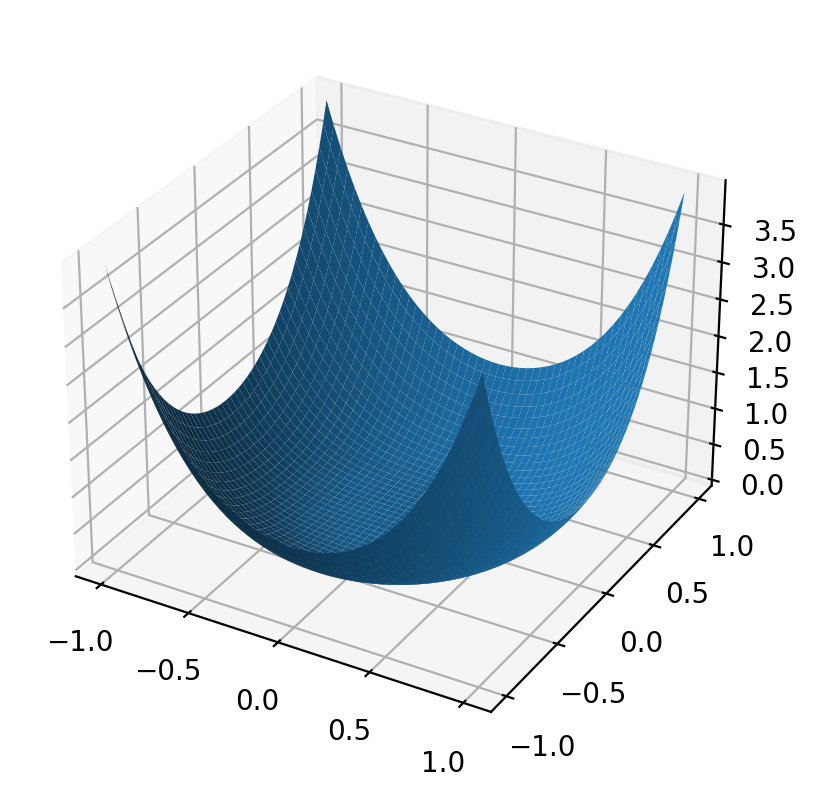

time taken:  204.3307900428772
neuron num 		 error 		 order
4 		 0.917426 		 * 		 

8 		 0.344804 		 1.411817 		 

16 		 0.118373 		 1.542434 		 

32 		 0.031961 		 1.888966 		 

64 		 0.008085 		 1.983001 		 

128 		 0.002018 		 2.001958 		 

256 		 0.000484 		 2.060883 		 

512 		 0.000147 		 1.720926 		 

1024 		 0.000035 		 2.069770 		 

2048 		 0.000010 		 1.752452 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.917426 &		 *  \\ \hline  

8 		 &  3.448e-01 &  		 1.41 \\ \hline  

16 		 &  1.184e-01 &  		 1.54 \\ \hline  

32 		 &  3.196e-02 &  		 1.89 \\ \hline  

64 		 &  8.085e-03 &  		 1.98 \\ \hline  

128 		 &  2.018e-03 &  		 2.00 \\ \hline  

256 		 &  4.838e-04 &  		 2.06 \\ \hline  

512 		 &  1.468e-04 &  		 1.72 \\ \hline  

1024 		 &  3.496e-05 &  		 2.07 \\ \hline  

2048 		 &  1.037e-05 &  		 1.75 \\ \hline  



In [17]:

#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    """ Target function for the Poisson equation
    """
    return (x[:,0:1]**2 + x[:,1:2]**2)**2  


# function_name = "gabor2d" 
function_name = "quartic2d" 
filename_write = "data_parameter_distribution_compare/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n") 
f_write.close() 

for N0 in [2**11]: 
    save = True
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 100
    order = 3    
    exponent = 11  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'model_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(my_model.state_dict(),filename)

    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 



In [36]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots

def plot_front_back_views_x_filtered(points, 
                                     point_color='red', 
                                     point_size=2.5, 
                                     sphere_opacity=0.3,
                                     north_pole_color='green',
                                     south_pole_color='blue',
                                     pole_size=10,
                                     pole_symbol='diamond',
                                     renderer='browser'):
    """
    Plots the scattered points on a unit sphere from two viewpoints based on the x-coordinate:
    - "Front" view: points with x > 0.
    - "Back" view: points with x ≤ 0.
    The sphere surface and pole markers are included in both views.
    
    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points.
    - point_size (int): Size of the scatter points.
    - sphere_opacity (float): Opacity of the unit sphere surface.
    - north_pole_color (str): Color for the North Pole marker.
    - south_pole_color (str): Color for the South Pole marker.
    - pole_size (int): Size of the pole markers.
    - pole_symbol (str): Marker symbol for the poles.
    - renderer (str): Plotly renderer type (e.g., 'browser', 'notebook').
    """
    
    # Set Plotly renderer
    pio.renderers.default = renderer

    # Ensure points is a NumPy array with shape (N,3)
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")
    
    # Split points based on x-coordinate:
    front_points = points[points[:, 0] > 0]
    back_points  = points[points[:, 0] <= 0]

    # Generate coordinates for the unit sphere surface
    u = np.linspace(0, 2 * np.pi, 50)
    v = np.linspace(0, np.pi, 50)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface trace
    sphere_surface = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Create scatter trace for front points (x > 0)
    scatter_front = go.Scatter3d(
        x=front_points[:, 0],
        y=front_points[:, 1],
        z=front_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Front Points (x > 0)'
    )

    # Create scatter trace for back points (x <= 0)
    scatter_back = go.Scatter3d(
        x=back_points[:, 0],
        y=back_points[:, 1],
        z=back_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Back Points (x ≤ 0)'
    )

    # Define North and South Pole markers (shown in both views)
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Create a subplot with 1 row and 2 columns for front/back views
    fig = make_subplots(
        rows=1, cols=2,
        specs=[[{'type': 'scene'}, {'type': 'scene'}]],
        subplot_titles=["Front View (x > 0)", "Back View (x ≤ 0)"],
        horizontal_spacing=0.02
    )

    # Add traces for the front view (only front_points)
    fig.add_trace(sphere_surface, row=1, col=1)
    fig.add_trace(scatter_front, row=1, col=1)
    fig.add_trace(north_pole, row=1, col=1)
    fig.add_trace(south_pole, row=1, col=1)

    # Add traces for the back view (only back_points)
    fig.add_trace(sphere_surface, row=1, col=2)
    fig.add_trace(scatter_back, row=1, col=2)
    fig.add_trace(north_pole, row=1, col=2)
    fig.add_trace(south_pole, row=1, col=2)

    # Define camera views:
    # Front view: camera looking from the positive x direction.
    front_camera = dict(eye=dict(x=2, y=0, z=0))
    # Back view: camera looking from the negative x direction.
    back_camera  = dict(eye=dict(x=-2, y=0, z=0))

    # Update layout for each scene
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=front_camera,
            aspectmode='cube'
        ),
        scene2=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=back_camera,
            aspectmode='cube'
        ),
        title_text='Front and Back Views of Points on a Sphere (Filtered by x-coordinate)',
        width=1200,
        height=600
    )

    fig.show()

# Example usage:
if __name__ == "__main__":
    # Generate some random points on the sphere surface
    np.random.seed(0)
    num_points = 500
    xyz = np.random.normal(size=(num_points, 3))
    norms = np.linalg.norm(xyz, axis=1, keepdims=True)
    xyz = xyz / norms  # normalize so points lie on the unit sphere

    plot_front_back_views_x_filtered(xyz,renderer='notebook')


In [26]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

def plot_interactive_sphere(points, 
                            point_color='red', 
                            point_size=3, 
                            sphere_color='cyan', 
                            sphere_opacity=0.3,
                            north_pole_color='green',
                            south_pole_color='blue',
                            pole_size=10,
                            pole_symbol='diamond',
                            title='Interactive 3D Plot on Unit Sphere',
                            renderer='browser'):
    """
    Plots an interactive 3D scatter plot on a unit sphere, including the North and South Poles.

    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points. Default is 'red'.
    - point_size (int): Size of the scatter points. Default is 5.
    - sphere_color (str): Base color of the unit sphere. Default is 'cyan'.
    - sphere_opacity (float): Opacity of the sphere (0 to 1). Default is 0.3.
    - north_pole_color (str): Color of the North Pole marker. Default is 'green'.
    - south_pole_color (str): Color of the South Pole marker. Default is 'blue'.
    - pole_size (int): Size of the pole markers. Default is 10.
    - pole_symbol (str): Marker symbol for the poles. Default is 'diamond'.
    - title (str): Title of the plot. Default is 'Interactive 3D Plot on Unit Sphere'.
    - renderer (str): Plotly renderer type. Default is 'browser'.

    Returns:
    - None. Displays the interactive plot.
    """

    # Ensure points are a NumPy array
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")

    # Set Plotly renderer
    pio.renderers.default = renderer

    # Create scatter plot for the main points
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Scatter Points'
    )

    # Create unit sphere coordinates
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface
    sphere = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Define North Pole
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    # Define South Pole
    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Define layout
    layout = go.Layout(
        title=title,
        scene=dict(
            xaxis=dict(title='X-axis'),
            yaxis=dict(title='Y-axis'),
            zaxis=dict(title='Z-axis'),
            aspectmode='data'  # Ensures equal scaling
        ),
        width=800,
        height=700
    )

    # Create figure with all traces
    fig = go.Figure(data=[sphere, scatter, north_pole, south_pole], layout=layout)

    # Display the plot
    fig.show()


w = my_model.fc1.weight.data 
b = my_model.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')

plot_front_back_views_x_filtered(w_b,renderer='notebook')

In [39]:
w_b_half = torch.load('one-cosine-pi.pt',map_location=torch.device('cpu'))
plot_front_back_views_x_filtered(w_b_half,renderer='notebook')

In [84]:
import torch
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

# Set default renderer (optional)
# You can change 'browser', 'notebook', etc., depending on your environment
pio.renderers.default = 'notebook'  # Opens in the default web browser

# Assuming my_model is already defined and loaded
# Uncomment the following line if you need to visualize 2D data
# plot_2D(my_model.cpu())

# Extract weights and biases from the first fully connected layer
w = my_model.fc1.weight.data 
b = my_model.fc1.bias.data 
w_b = torch.cat((w, b.reshape(-1, 1)), 1) 

# Normalize the weights along dimension 1
w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)

# Parameters for plotting
neuron_num = 200  # Number of neurons to plot (adjust as needed)

# Extract coordinates
x_coords = w_b_normalized[:neuron_num, 0].numpy()
y_coords = w_b_normalized[:neuron_num, 1].numpy()
z_coords = w_b_normalized[:neuron_num, 2].numpy()

# Create scatter plot for normalized weights
scatter = go.Scatter3d(
    x=x_coords,
    y=y_coords,
    z=z_coords,
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        opacity=0.8,
        line=dict(width=0.5, color='white')
    ),
    name='Normalized Weights'
)

# Create the unit sphere
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
sphere_x = np.outer(np.cos(u), np.sin(v))
sphere_y = np.outer(np.sin(u), np.sin(v))
sphere_z = np.outer(np.ones(np.size(u)), np.cos(v))

# Create mesh for the sphere
sphere = go.Surface(
    x=sphere_x,
    y=sphere_y,
    z=sphere_z,
    colorscale='Blues',
    opacity=0.3,
    showscale=False,
    name='Unit Sphere'
)

# Define the layout
layout = go.Layout(
    title='Interactive 3D Plot of Normalized Weights on a Unit Sphere',
    scene=dict(
        xaxis=dict(title='X-axis'),
        yaxis=dict(title='Y-axis'),
        zaxis=dict(title='Z-axis'),
        aspectmode='data'  # Ensures equal scaling for all axes
    ),
    legend=dict(
        itemsizing='constant'
    ),
    width=800,
    height=700
)

# Combine the scatter and sphere
fig = go.Figure(data=[sphere, scatter], layout=layout)

# Add legend manually since Plotly doesn't handle legends for surfaces by default
fig.update_layout(
    showlegend=True,
    legend=dict(
        x=0.8,
        y=0.95,
        bgcolor='rgba(255,255,255,0.5)',
        bordercolor='Black',
        borderwidth=1
    )
)

# To add custom legend entries, use annotations or other workarounds
# However, for simplicity, we'll rely on hover information

# Display the plot
fig.show()


## Random feature method - 1 
- $(\omega, b) \in S^{1} \times [-\sqrt{2},\sqrt{2}]$


## Random feature method - 2 

- $(\omega, b) \in S^{2}$
- $\Omega = [0,1]^2$

In [88]:
points = torch.randn(100,3)
points = points/torch.norm(points, dim=1, keepdim=True)

plot_interactive_sphere(points,renderer='notebook')


In [109]:
# generate uniform points on the sphere 
neuron_nums = 1000 
indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
phi = torch.acos(1 - 2*indices/neuron_nums)
theta = pi * (1 + 5**0.5) * indices
x = torch.sin(phi) * torch.cos(theta)
y = torch.sin(phi) * torch.sin(theta)
z = torch.cos(phi)
points = torch.stack((x, y, z), dim=1) 
plot_interactive_sphere(points,renderer='notebook')




In [116]:
def generate_fibonacci_sphere_numpy(num_points):
    """
    Generates points uniformly distributed on a unit sphere using the Fibonacci lattice method.

    Parameters:
    - num_points (int): Number of points to generate.

    Returns:
    - points (np.ndarray): An (N, 3) array of 3D coordinates on the unit sphere.
    """
    indices = np.arange(0, num_points) + 0.5

    # Golden angle in radians
    golden_angle = np.pi * (3 - np.sqrt(5)) # np.pi * (1 + 5**0.5)  # 
    phi = np.arccos(1 - 2 * indices / num_points)  # Polar angle

    theta = golden_angle * indices  # Azimuthal angle

    x = np.sin(phi) * np.cos(theta)
    y = np.sin(phi) * np.sin(theta)
    z = np.cos(phi)

    points = np.stack((x, y, z), axis=1)
    return points

points = generate_fibonacci_sphere_numpy(1000)
plot_interactive_sphere(points,renderer='notebook') 

In [51]:
def generate_relu_dict2D_QMC(s,N0):

    samples = torch.rand(s*N0,2) 
    
    T =torch.tensor([[2*pi,0],[0,2.84]])

    shift = torch.tensor([0,-1.42]) 

    samples = samples@T + shift 

    theta = samples[:,0].reshape(s*N0,1)
    W1 = torch.cos(theta)
    W2 = torch.sin(theta)
    W = torch.cat((W1,W2),1) # N1 x 2
    # b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1) 
    b = samples[:,1].reshape(s*N0,1)
    
    Wb = torch.cat((W,b),1) # N1 x 3 

def initialize_model_1(my_model):
    # w ~ U(S^1), b ~ U(-1.42,1.42), random 
    neuron_nums = my_model.fc1.bias.size(0)
    samples = torch.rand(neuron_nums,2) 
    T =torch.tensor([[2*pi,0],[0,2.84]])
    shift = torch.tensor([0,-1.42]) 
    samples = samples@T + shift 
    theta = samples[:,0].reshape(neuron_nums,1)
    W1 = torch.cos(theta)
    W2 = torch.sin(theta)
    W = torch.cat((W1,W2),1) # N1 x 2
    b = samples[:,1].reshape(neuron_nums,1)
    my_model.fc1.weight.data[:,:] = W[:,:] 
    my_model.fc1.bias.data[:] = b[:,0] 
    
    return my_model 

def initialize_model_2(my_model):
    # (w,b) ~ U(S^2) random 
    neuron_nums = my_model.fc1.bias.size(0)
    points = torch.randn(neuron_nums,3)
    points = points/torch.norm(points, dim=1, keepdim=True)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]  
    return my_model 

def initialize_model_3(my_model):
    # generate a uniform grid on S^2 
    neuron_nums = my_model.fc1.bias.size(0) 

    indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
    phi = torch.acos(1 - 2*indices/neuron_nums)
    theta = pi * (1 + 5**0.5) * indices
    x = torch.sin(phi) * torch.cos(theta)
    y = torch.sin(phi) * torch.sin(theta)
    z = torch.cos(phi)

    points = torch.stack((x, y, z), dim=1)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]
    return my_model 
    
# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x): 
    return torch.cos(2*pi*x[:,0:1]) * torch.cos(2*pi*x[:,1:2])
integration_weights, integration_points = PiecewiseGQ2D_weights_points(100,3)
err_list = [] 
neuron_nums =  [2**j for j in range(2,10)] 
for neuron_num in neuron_nums: 
    my_model_rfm2 = model(2,neuron_num,1,1).to(device) 
    my_model_rfm2 = initialize_model_1(my_model_rfm2) 
    my_model_rfm2 = adjust_neuron_position(my_model_rfm2,2) 
    sol = minimize_linear_layer_explicit_assemble(my_model_rfm2,target,integration_weights, integration_points, "direct")
    my_model_rfm2.fc2.weight.data[0,:] = sol[:] 
    # plot_2D(my_model_rfm2) 
    err_l2 = (integration_weights.t()@(target(integration_points) - my_model_rfm2(integration_points).detach())**2)**0.5 
    print("L2 error: ",err_l2) 
    err_list.append(err_l2) 

# show convergence order 
err_list = [err.item() for err in err_list] 
print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
for i, item in enumerate(err_list):
    if i == 0: 
        print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
    else: 
        print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )


assembling the matrix time taken:  0.019493818283081055
solving Ax = b time taken:  0.0031328201293945312
L2 error:  tensor([[0.4997]])
assembling the matrix time taken:  0.02038121223449707
solving Ax = b time taken:  0.0009829998016357422
L2 error:  tensor([[0.4108]])
assembling the matrix time taken:  0.02538013458251953
solving Ax = b time taken:  0.0002219676971435547
L2 error:  tensor([[0.3407]])
assembling the matrix time taken:  0.042912960052490234
solving Ax = b time taken:  0.00026488304138183594
L2 error:  tensor([[0.2195]])
assembling the matrix time taken:  0.06966018676757812
solving Ax = b time taken:  0.00023293495178222656
L2 error:  tensor([[0.0800]])
assembling the matrix time taken:  0.14109086990356445
solving Ax = b time taken:  0.00040602684020996094
L2 error:  tensor([[0.0396]])
assembling the matrix time taken:  0.4164009094238281
solving Ax = b time taken:  0.001956939697265625
L2 error:  tensor([[0.0152]])
assembling the matrix time taken:  0.773117065429687

## Deterministic feature method - 3 

- $(\omega, b) \in S^{2}$
- $\Omega = [-1,1]^2$
- Remove Redundant features



In [95]:
def remove_redundant_neuron(my_model, dims = 3, choice = 1): 
    ##  choice 1:  [0,1]^d, choice 2: [-1,1]^d
    def create_mesh_grid(dims, pts):
        mesh = torch.tensor(list(itertools.product(pts,repeat=dims)))
        vertices = mesh.reshape(len(pts) ** dims, -1) 
        return vertices
    counter = 0 
    # positions = torch.tensor([[0.,0.],[0.,1.],[1.,1.],[1.,0.]])
    # pts = torch.tensor([0.,1.]) # for domain [0,1]^d 
    if choice == 1: 
        pts = torch.tensor([0.,1.])
    elif choice == 2:
        pts = torch.tensor([-1.,1.])# for domain [-1,1]^d 
    elif choice == 3:
        pts = torch.tensor([-1./2,1./2])# for domain [-1,1]^d 
    positions = create_mesh_grid(dims,pts) 
    neuron_num = my_model.fc1.bias.size(0)
    relu_k = my_model.k 
    recorded_neurons = []
    for i in range(neuron_num): 
        w = my_model.fc1.weight.data[i:i+1,:]
        b = my_model.fc1.bias.data[i]
        values = torch.matmul(positions,w.T)
        left_end = - torch.max(values)
        right_end = - torch.min(values)
        offset = (right_end - left_end)/50
        if b > left_end + offset/2 and b < right_end - offset/2: 
            recorded_neurons.append((w, b))
        elif b >= right_end - offset/2 and counter < (dims+1):
            recorded_neurons.append((w, b))
            counter += 1

    new_neuron_num = len(recorded_neurons)
    new_model = model(2, new_neuron_num, 1, k=relu_k).to(device)
    for i, (w, b) in enumerate(recorded_neurons):
        new_model.fc1.weight.data[i:i+1,:] = w
        new_model.fc1.bias.data[i] = b
    print("Number of neurons removed: ", neuron_num - new_neuron_num)
    print("Number of neurons left: ", new_neuron_num)  
    return new_model

In [140]:
def initialize_model_3(my_model):
    # generate a uniform grid on S^2 
    neuron_nums = my_model.fc1.bias.size(0) 

    indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
    phi = torch.acos(1 - 2*indices/neuron_nums)
    theta = pi * (1 + 5**0.5) * indices
    x = torch.sin(phi) * torch.cos(theta) 
    y = torch.sin(phi) * torch.sin(theta)  
    z = torch.cos(phi) 

    points = torch.stack((x, y, z), dim=1)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]
    return my_model 

def target(x):
    sigma = 0.15# s.d of Gaussian 
    frequency = 4  # frequency of cosine 
    z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
    return z 


# def target(x):
#     # sigma = 0.15# s.d of Gaussian 
#     # frequency = 4  # frequency of cosine 
#     # z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])

#     return torch.cos(pi*x[:,0:1]) * torch.cos(pi*x[:,1:2]) 

integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(100,3,bl = [-1/2,-1/2],ur = [1/2,1/2])
err_list = [] 
actual_neuron_list = [] 
# neuron_nums =  [2**j for j in range(2,12)] 
neuron_nums =  [100,200,400,800] 

relu_k = 2 
for neuron_num in neuron_nums: 
    my_model_rfm2 = model(2,neuron_num,1,k = relu_k).to(device) 
    my_model_rfm2 = initialize_model_3(my_model_rfm2) 
    # my_model_rfm2 = adjust_neuron_position(my_model_rfm2,2) 
    my_model_rfm2 = remove_redundant_neuron(my_model_rfm2,2,choice=3)
    sol = minimize_linear_layer_explicit_assemble(my_model_rfm2,target,integration_weights, integration_points, "direct")
    my_model_rfm2.fc2.weight.data[0,:] = sol[:] 
    # plot_2D(my_model_rfm2) 
    err_l2 = (integration_weights.t()@(target(integration_points) - my_model_rfm2(integration_points).detach())**2)**0.5 
    print("L2 error: ",err_l2) 
    err_list.append(err_l2) 
    actual_neuron_list.append(my_model_rfm2.fc1.bias.size(0)) 

# show convergence order 
err_list = [err.item() for err in err_list] 
print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
for i, item in enumerate(err_list):
    if i == 0: 
        print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(actual_neuron_list[i],item, np.log(err_list[i-1]/err_list[i])/np.log(actual_neuron_list[i]/actual_neuron_list[i-1]) ) )   
    else: 
        print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(actual_neuron_list[i],item, np.log(err_list[i-1]/err_list[i])/np.log(actual_neuron_list[i]/actual_neuron_list[i-1]) ) )


Number of neurons removed:  45
Number of neurons left:  55
assembling the matrix time taken:  0.07214999198913574
solving Ax = b time taken:  0.00036025047302246094
L2 error:  tensor([[0.0507]])
Number of neurons removed:  90
Number of neurons left:  110
assembling the matrix time taken:  0.16471505165100098
solving Ax = b time taken:  0.00038313865661621094
L2 error:  tensor([[0.0281]])
Number of neurons removed:  188
Number of neurons left:  212
assembling the matrix time taken:  0.37800121307373047
solving Ax = b time taken:  0.0011789798736572266
L2 error:  tensor([[0.0138]])
Number of neurons removed:  377
Number of neurons left:  423
assembling the matrix time taken:  0.6421041488647461
solving Ax = b time taken:  0.005645036697387695
L2 error:  tensor([[0.0047]])
neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
55 		 & 0.050693 &		 *  \\ \hline  

110 		 &  2.806e-02 &  		 0.85 \\ \hline  

212 		 &  1.376e-02 &  		 1.09 \\ \hline  

423 		 &  4.727e-03 &  		 1.55 

In [134]:
my_model_rfm2

model(
  (fc1): Linear(in_features=2, out_features=897, bias=True)
  (fc2): Linear(in_features=897, out_features=1, bias=False)
)

In [163]:
w = my_model_rfm2.fc1.weight.data 
b = my_model_rfm2.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)

plot_interactive_sphere(w_b_normalized, point_size=3, title = "Deterministic Uniform grid on a sphere", renderer='notebook') 